In [1]:
import pandas as pd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import json
from IPython.display import display, Markdown

import sys
sys.path.append('../')

import utils
from evalutils.roc import get_bootstrapped_roc_ci_curves
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

## directory where results are
EXPERIMENT_DIR = f"/data/bodyct/experiments/lung-malignancy-fairness-shaurya"
NLST_PREDS = f"{EXPERIMENT_DIR}/nlst"

TEAMS_DIR = "C:/Users/shaur/OneDrive - Radboudumc/Documents - Master - Shaurya Gaur/General/Malignancy-Estimation Results/nlst"
NLST_PREDS = TEAMS_DIR ## Comment out if not using Teams backup (aka Chansey is up :)

In [2]:
nlst_preds_nodule = pd.read_csv(f"{NLST_PREDS}/nlst_demov4_allmodels_cal.csv")
nlst_preds_nodule.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16077 entries, 0 to 16076
Columns: 123 entries, PatientID to LC_stage
dtypes: bool(25), float64(84), int64(11), object(3)
memory usage: 12.4+ MB


In [3]:
with open(f'{NLST_PREDS}/nlst_demo_v4_cols.json') as json_data:
    nlst_democols = json.load(json_data)
    json_data.close()

nlst_democols

{'num': {'demo': ['height', 'weight', 'Age', 'BMI'],
  'smoke': ['pkyr', 'smokeage', 'smokeday', 'smokeyr'],
  'nodule': ['CoordX', 'CoordY', 'CoordZ'],
  'other': ['NoduleCounts', 'Diameter [mm]'],
  'lungcanc': ['LC_stage']},
 'cat': {'demo': ['marital',
   'educat',
   'race',
   'ethnic',
   'Gender',
   'Married',
   'NonHispanicWhite',
   'HighSchoolPlus'],
  'smoke': ['cigar', 'cigsmok', 'pipe', 'smokelive', 'smokework'],
  'work': ['wrkasbe',
   'wrkbaki',
   'wrkbutc',
   'wrkchem',
   'wrkcoal',
   'wrkcott',
   'wrkfarm',
   'wrkfire',
   'wrkflou',
   'wrkfoun',
   'wrkhard',
   'wrkpain',
   'wrksand',
   'wrkweld'],
  'disease': ['diagadas',
   'diagasbe',
   'diagbron',
   'diagchas',
   'diagchro',
   'diagcopd',
   'diagdiab',
   'diagemph',
   'diagfibr',
   'diaghear',
   'diaghype',
   'diagpneu',
   'diagsarc',
   'diagsili',
   'diagstro',
   'diagtube'],
  'canchist': ['cancblad',
   'cancbrea',
   'canccerv',
   'canccolo',
   'cancesop',
   'canckidn',
   'canc

In [4]:
# nlst_preds_nodule['PersonalCancerHist'] = nlst_preds_nodule[nlst_democols['cat']['canchist']].any(axis=1)

In [5]:
nlst_preds = utils.prep_nlst_preds(nlst_preds_nodule, scanlevel=True, tijmen=False, sybil=True)
nlst_preds.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5911 entries, 0 to 10150
Columns: 118 entries, PatientID to LC_stage
dtypes: bool(25), float64(81), int64(11), object(1)
memory usage: 4.4+ MB


In [6]:
MODEL_TO_COL = {
    "Venkadesh": "DL_cal",
    # "de Haas Combined": "Thijmen_mean",
    "de Haas Local": "Thijmen_local_cal",
    "de Haas Global (hidden nodule)": "Thijmen_global_hidden_cal",
    "de Haas Global (shown nodule)": "Thijmen_global_show_cal",
    "PanCan2b": "PanCan2b",
    "Sybil year 1": "sybil_year1",
    # "Sybil year 2": "sybil_year2",
    # "Sybil year 3": "sybil_year3",
    # "Sybil year 4": "sybil_year4",
    # "Sybil year 5": "sybil_year5",
    # "Sybil year 6": "sybil_year6",
}

Sanity check - let's see internal NLST validation results.

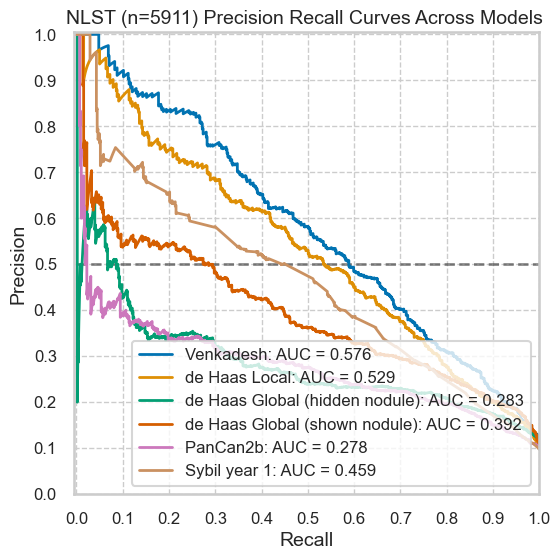

,Venkadesh,de Haas Local,de Haas Global (hidden nodule),de Haas Global (shown nodule),PanCan2b,Sybil year 1
score,0.576449,0.529377,0.282776,0.392441,0.278431,0.45871


In [7]:
utils.prcs_models(nlst_preds, models=MODEL_TO_COL, dataset_label="NLST")

## Plot results by category

In [8]:
def plot_by_category(df, cat):
    display(Markdown(f"#### {cat}"))
    catinfo, aucs, sigtestresults = utils.prc_by_category(df, cat, MODEL_TO_COL, min_mal=10)
    display(catinfo)
    
    if sigtestresults is not None:
        print("Hanley-McNeil significance test results:")
        display(sigtestresults)
    else:
        print("Not binary: not computing significance test results.")

    # for m in aucs: 
    #     print(m)
    #     display(aucs[m])

### Included columns (from predictions)

#### wrknomask

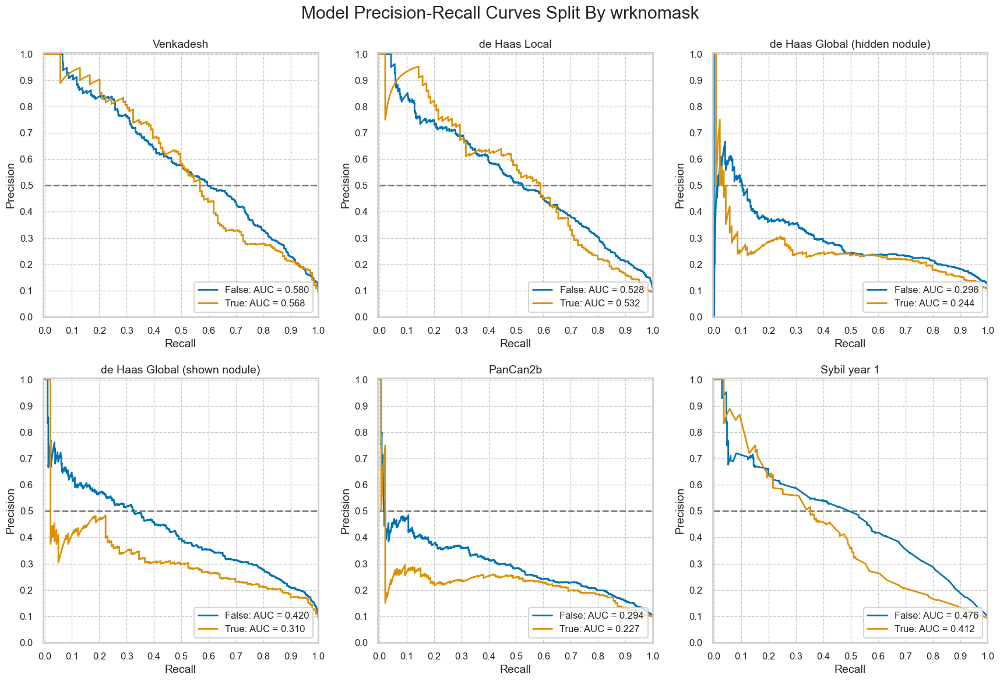

,num,pct,num_mal,pct_mal
False,4407,74.555913,442,10.029499
True,1504,25.444087,139,9.242021


Not binary: not computing significance test results.


#### FamilyHistoryLungCa

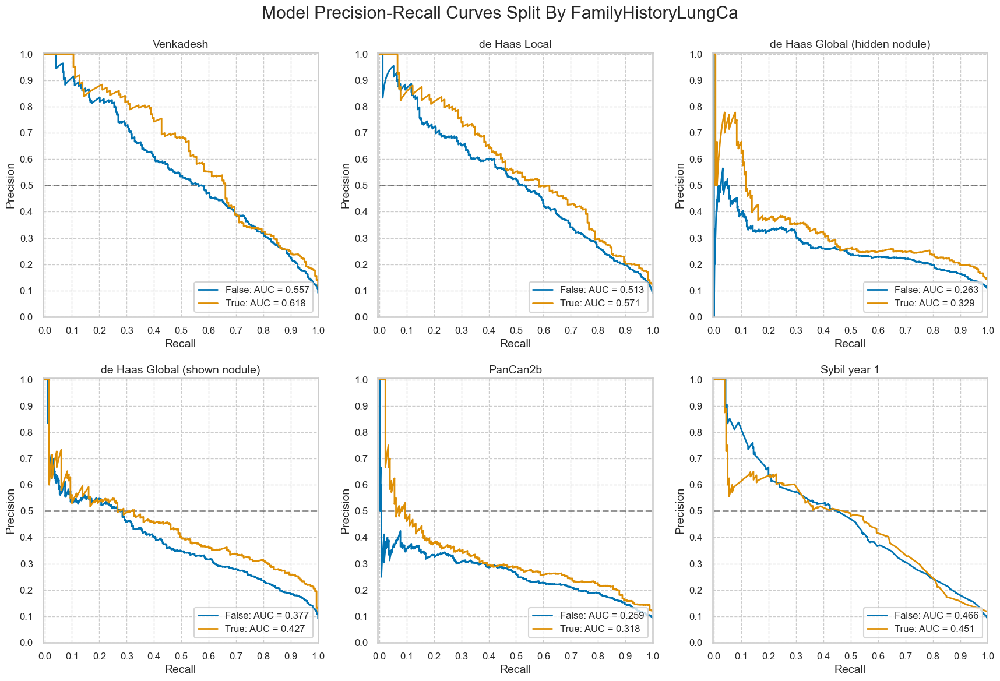

,num,pct,num_mal,pct_mal
False,4384,74.166808,401,9.146898
True,1527,25.833192,180,11.787819


Not binary: not computing significance test results.


#### PersonalCancerHist

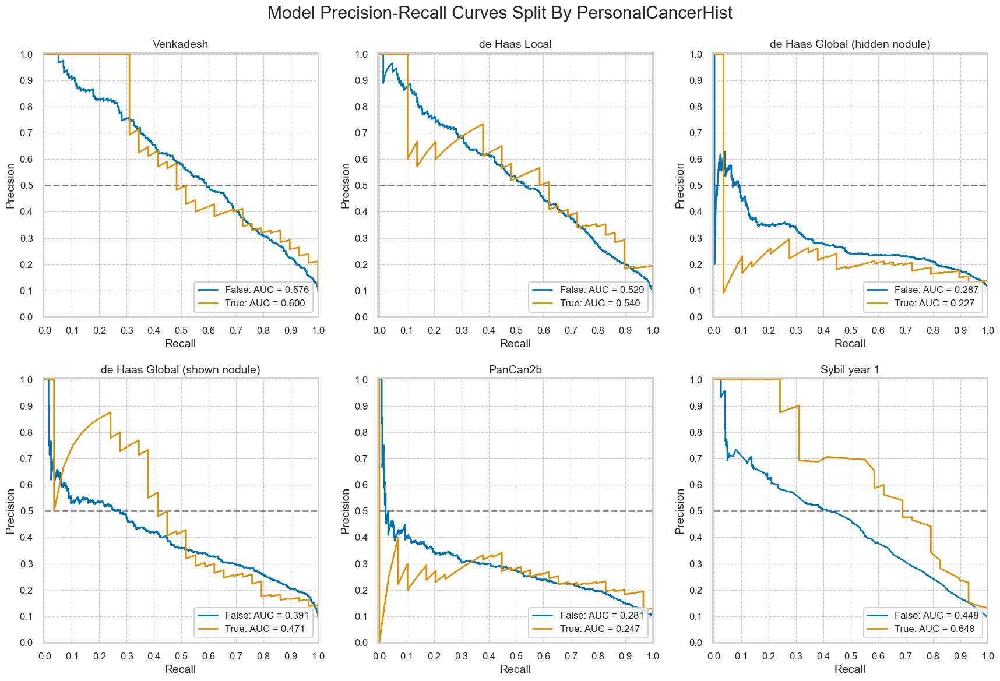

,num,pct,num_mal,pct_mal
False,5638,95.381492,552,9.790706
True,273,4.618508,29,10.622711


Not binary: not computing significance test results.


#### Emphysema

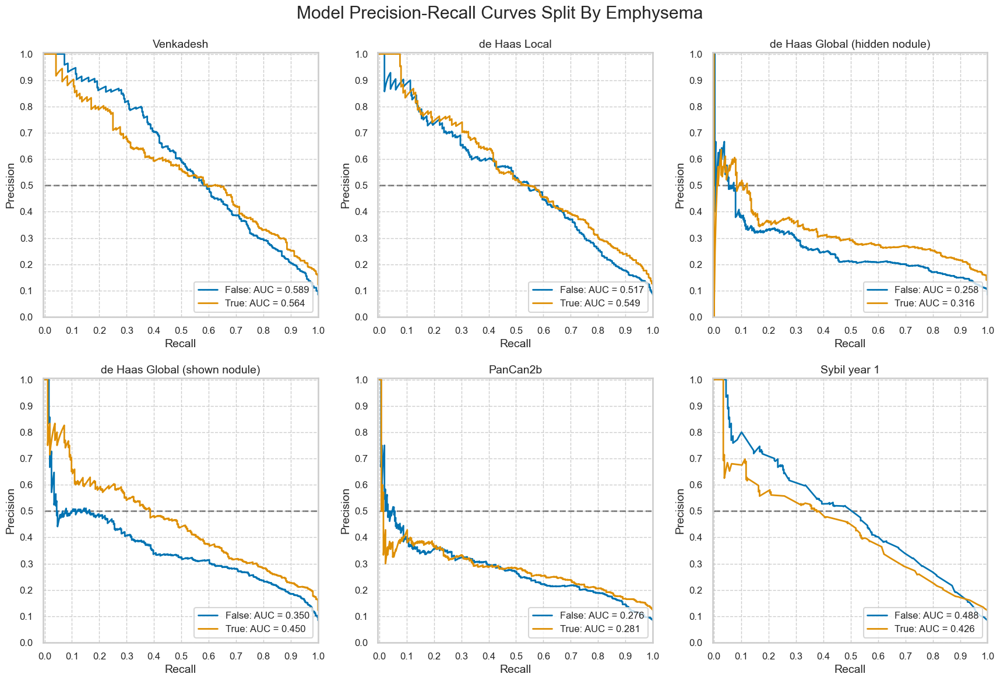

,num,pct,num_mal,pct_mal
False,3755,63.52563,317,8.442077
True,2156,36.47437,264,12.244898


Not binary: not computing significance test results.


In [9]:
for c in nlst_democols['cat']['other']:
    plot_by_category(nlst_preds, c)

### Nodule information

#### Spiculation

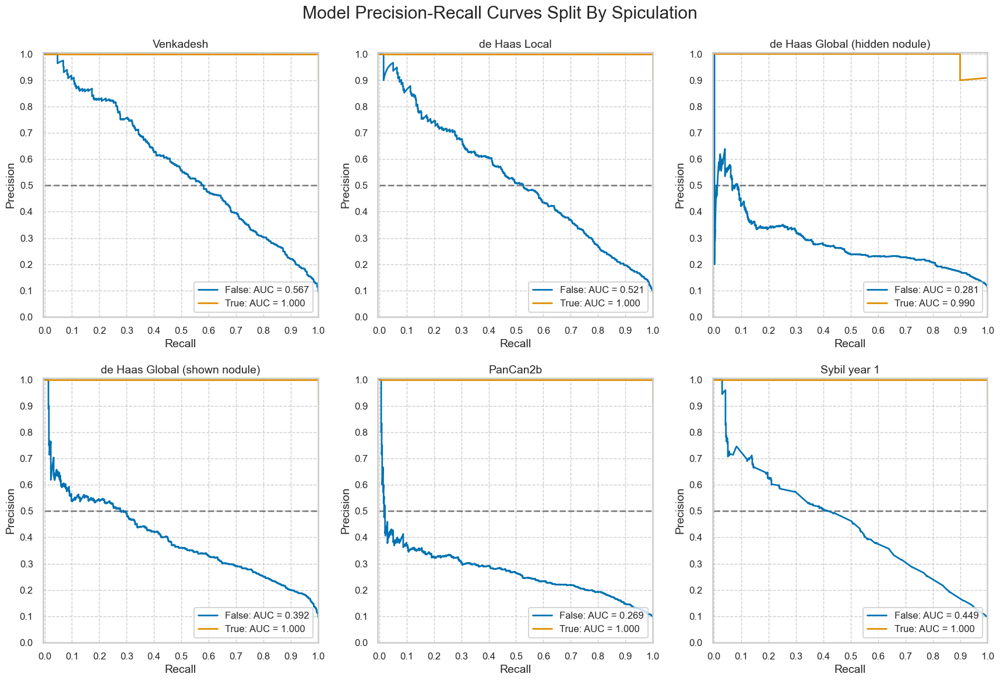

,num,pct,num_mal,pct_mal
False,5900,99.813906,571,9.677966
True,11,0.186094,10,90.909091


Not binary: not computing significance test results.


#### NoduleInUpperLung

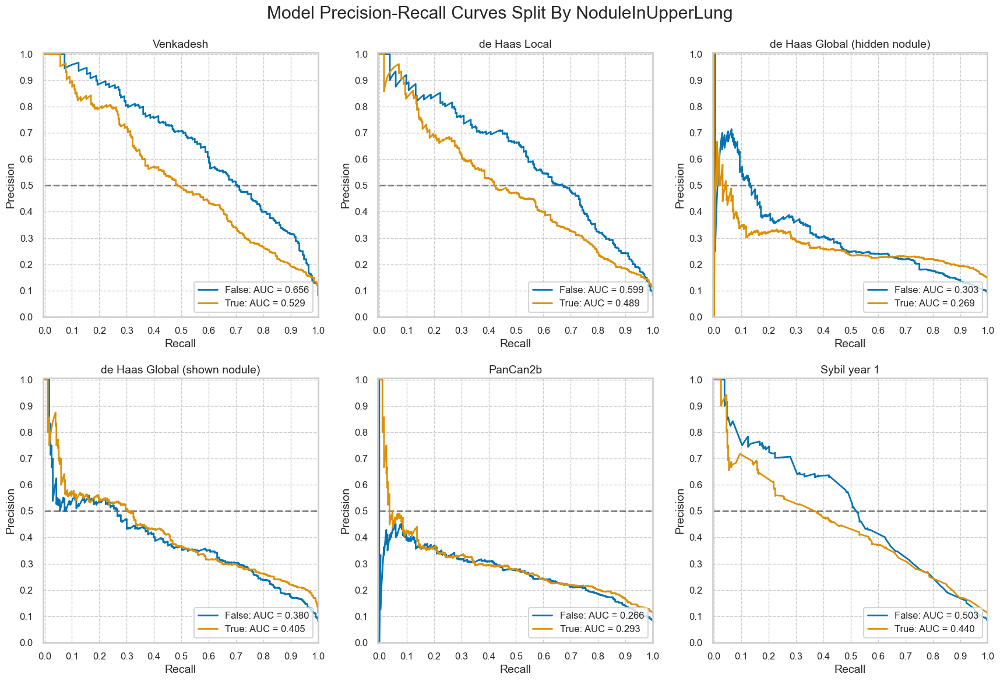

,num,pct,num_mal,pct_mal
False,2850,48.215192,233,8.175439
True,3061,51.784808,348,11.368834


Not binary: not computing significance test results.


#### Solid

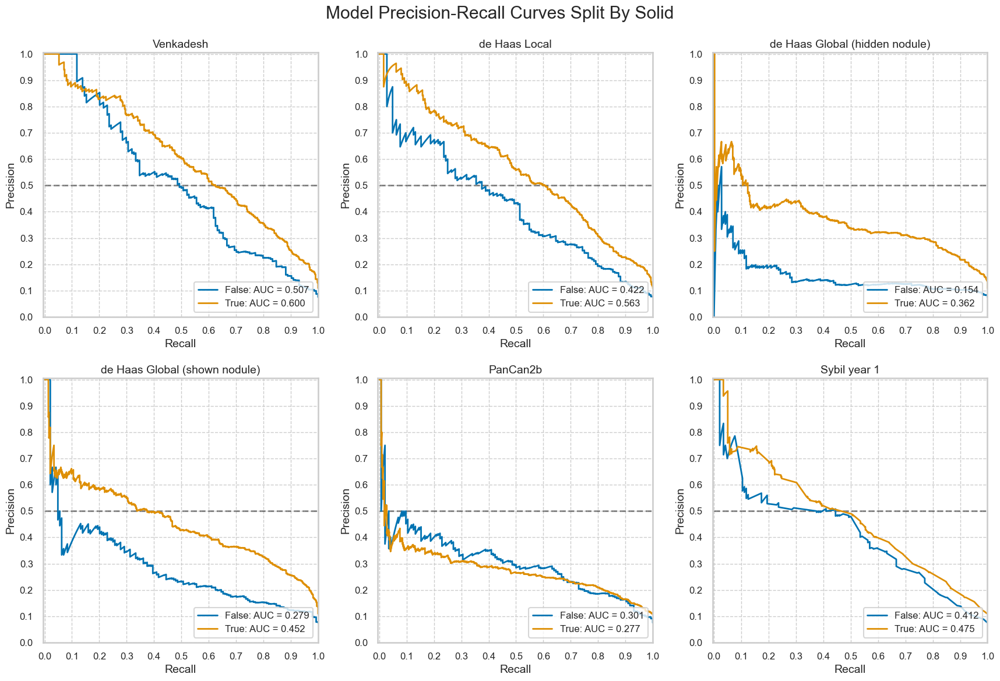

,num,pct,num_mal,pct_mal
False,1911,32.329555,144,7.535322
True,4000,67.670445,437,10.925000


Not binary: not computing significance test results.


#### GroundGlassOpacity

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
False,4275,72.322788,581,13.590643
True,1636,27.677212,0,0.000000


Not binary: not computing significance test results.


#### Perifissural

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
False,5387,91.135172,581,10.785224
True,524,8.864828,0,0.000000


Not binary: not computing significance test results.


#### NonSolid

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
False,5858,99.103367,528,9.013315
True,53,0.896633,53,100.000000


Not binary: not computing significance test results.


#### PartSolid

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
False,5808,98.257486,478,8.230028
True,103,1.742514,103,100.000000


Not binary: not computing significance test results.


#### SemiSolid

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
False,5159,87.277956,581,11.261872
True,752,12.722044,0,0.000000


Not binary: not computing significance test results.


#### Calcified

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
False,5906,99.915412,581,9.837453
True,5,0.084588,0,0.000000


Not binary: not computing significance test results.


In [10]:
for cat in nlst_democols['cat']['nodule']:
    plot_by_category(nlst_preds, cat)

### Demographics

#### marital

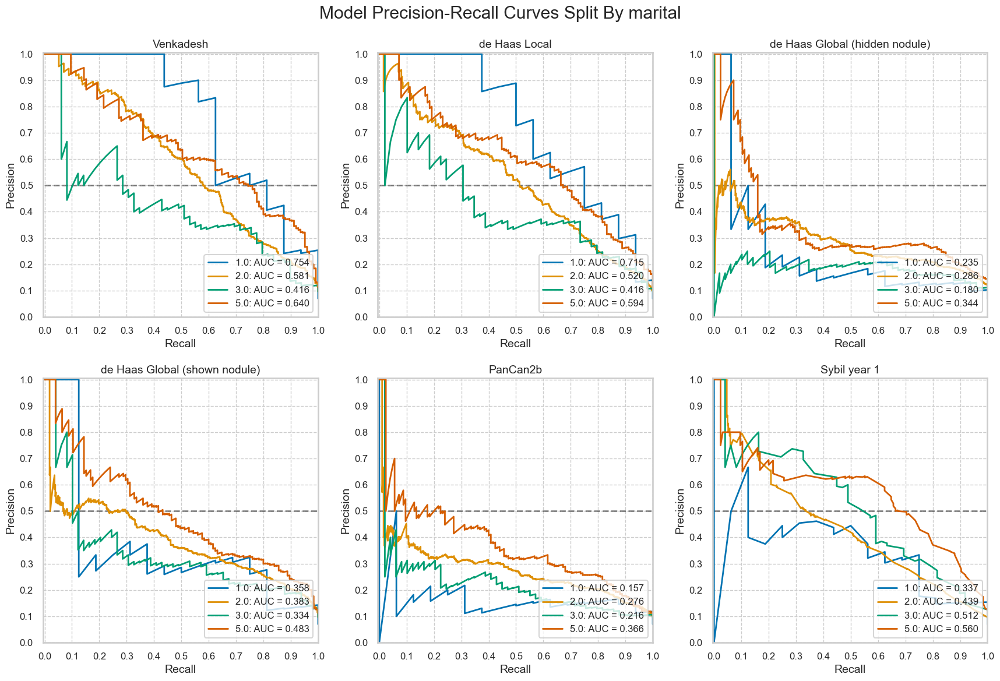

,num,pct,num_mal,pct_mal
1.0,229,3.882672,16,6.986900
2.0,3974,67.378772,384,9.662808
3.0,507,8.596134,49,9.664694
4.0,65,1.102068,5,7.692308
5.0,1123,19.040353,125,11.130899


Not binary: not computing significance test results.


#### educat

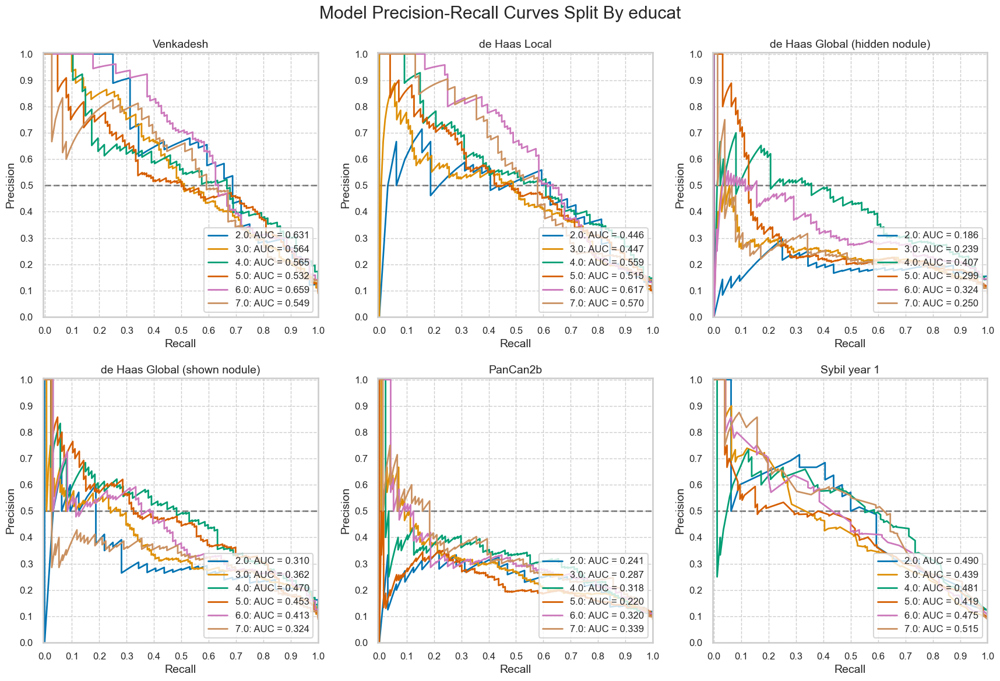

,num,pct,num_mal,pct_mal
1.0,111,1.913793,9,8.108108
2.0,290,5.000000,32,11.034483
3.0,1479,25.500000,141,9.533469
4.0,852,14.689655,87,10.211268
5.0,1301,22.431034,126,9.684858
6.0,913,15.741379,96,10.514786
7.0,854,14.724138,76,8.899297


Not binary: not computing significance test results.


#### race

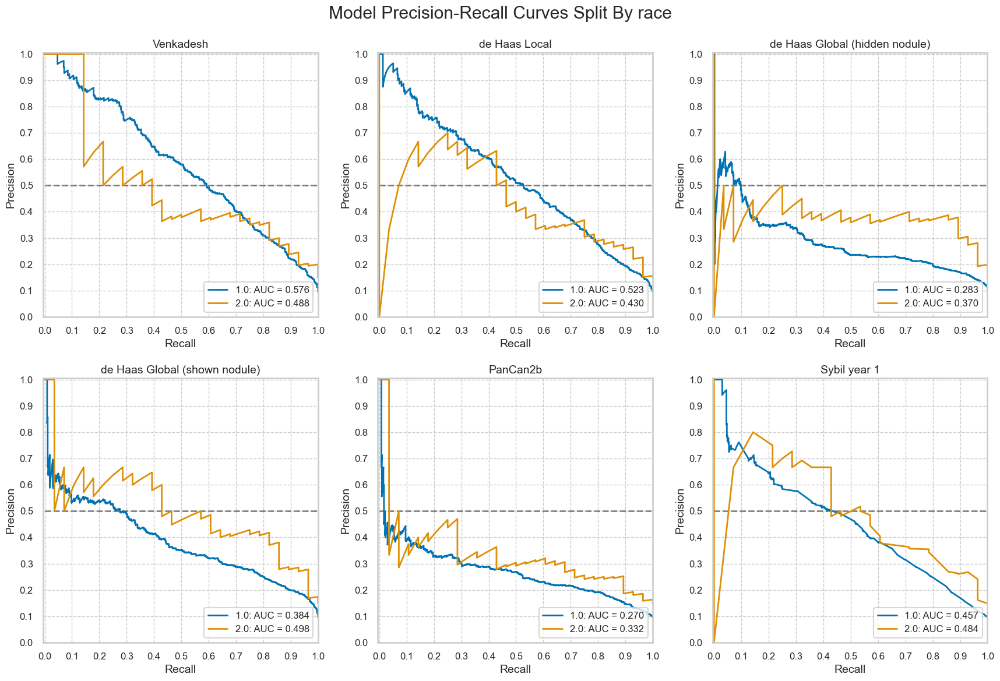

,num,pct,num_mal,pct_mal
1.0,5523,93.785023,530,9.596234
2.0,188,3.192393,28,14.893617
3.0,72,1.222618,6,8.333333
4.0,23,0.390559,8,34.782609
5.0,18,0.305655,1,5.555556
6.0,65,1.103753,6,9.230769


Not binary: not computing significance test results.


#### ethnic

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
1.0,98,1.667517,4,4.081633
2.0,5779,98.332483,574,9.932514


Not binary: not computing significance test results.


#### Gender

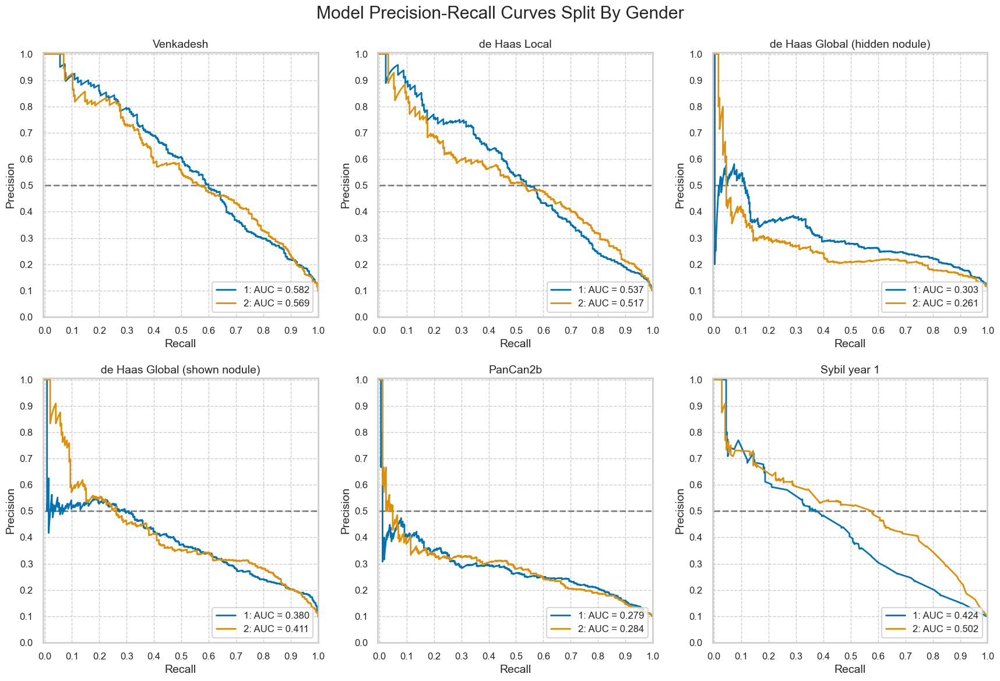

,num,pct,num_mal,pct_mal
1,3441,58.2135,337,9.793665
2,2470,41.7865,244,9.878543


Not binary: not computing significance test results.


#### Married

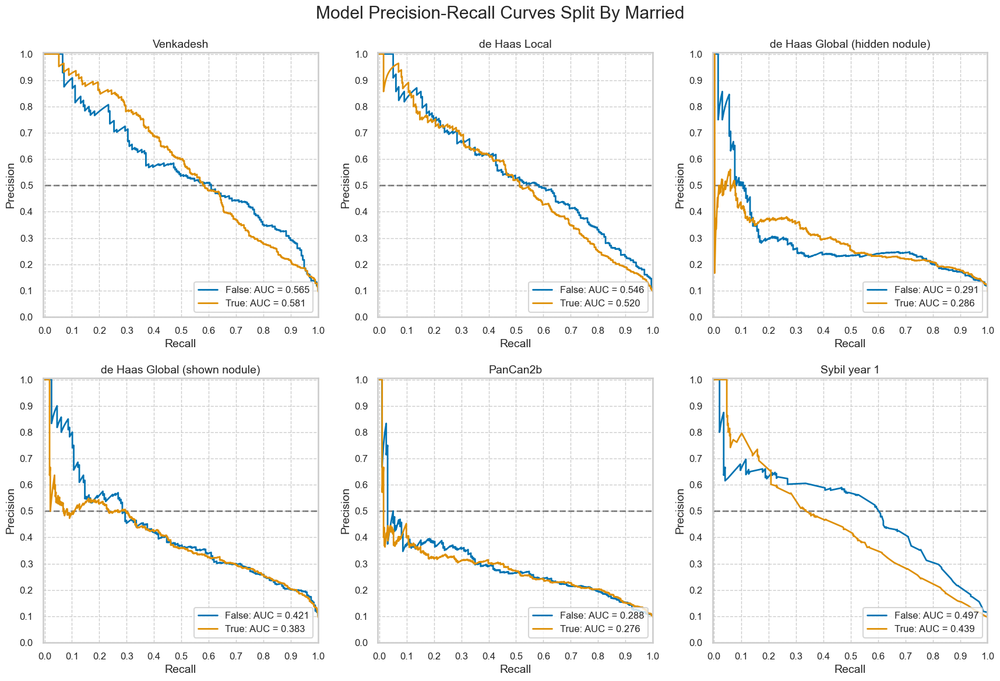

,num,pct,num_mal,pct_mal
False,1937,32.769413,197,10.170367
True,3974,67.230587,384,9.662808


Not binary: not computing significance test results.


#### NonHispanicWhite

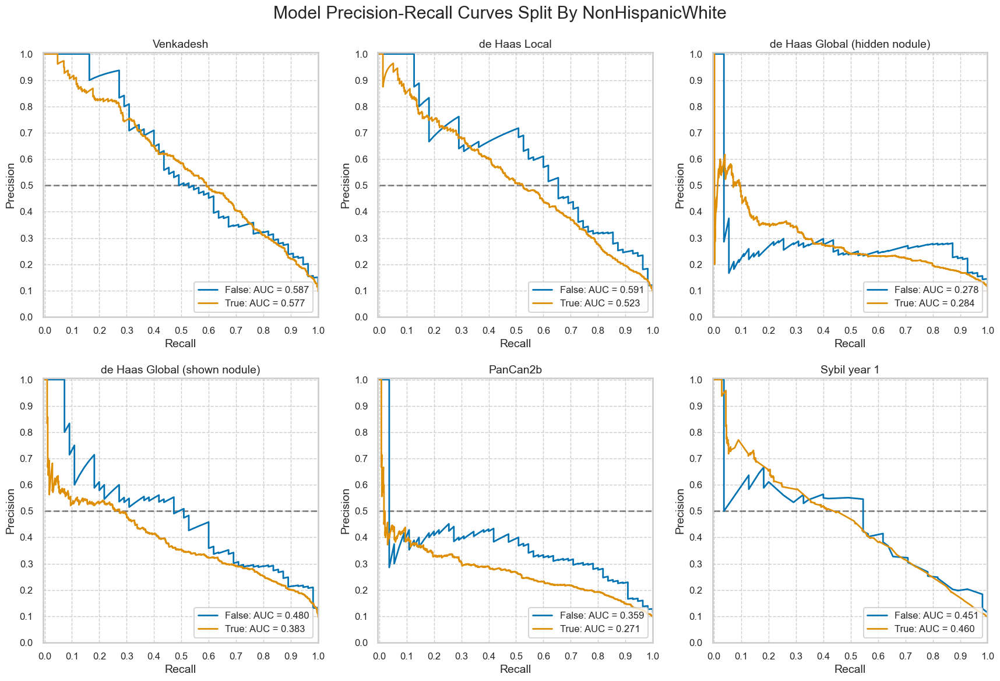

,num,pct,num_mal,pct_mal
False,481,8.137371,55,11.434511
True,5430,91.862629,526,9.686924


Not binary: not computing significance test results.


#### HighSchoolPlus

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
False,111,1.877855,9,8.108108
True,5800,98.122145,572,9.862069


Not binary: not computing significance test results.


In [11]:
for cat in nlst_democols['cat']['demo']:
    plot_by_category(nlst_preds, cat)

In [12]:
nlst_preds['Unfinished_ed'] = (nlst_preds['educat'] == 2) | (nlst_preds['educat'] == 5)
nlst_preds['Unfinished_ed'].value_counts(dropna=False)

Unfinished_ed
False    4320
True     1591
Name: count, dtype: int64

#### Unfinished_ed

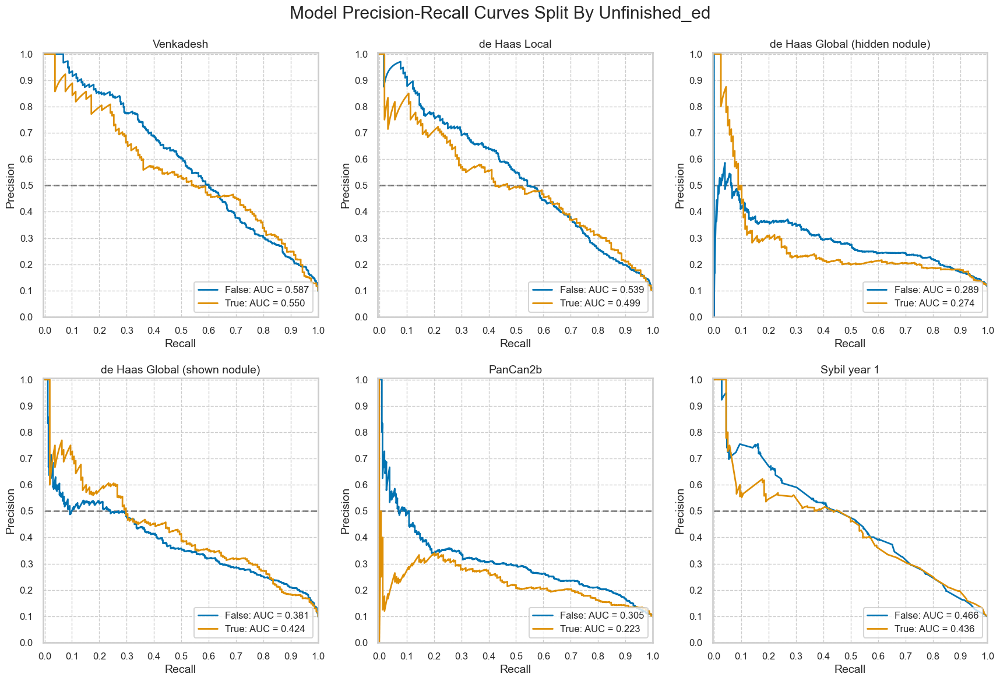

,num,pct,num_mal,pct_mal
False,4320,73.084081,423,9.791667
True,1591,26.915919,158,9.930861


Not binary: not computing significance test results.


In [13]:
plot_by_category(nlst_preds, 'Unfinished_ed')

### Smoking

#### cigar

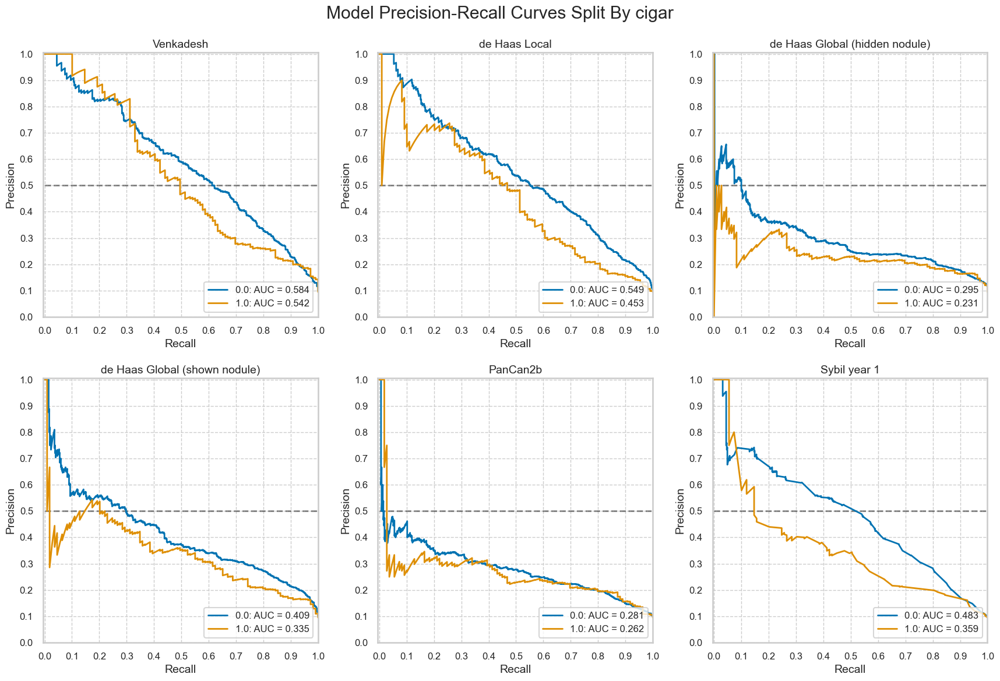

,num,pct,num_mal,pct_mal
0.0,4738,80.496092,470,9.919797
1.0,1148,19.503908,109,9.494774


Not binary: not computing significance test results.


#### cigsmok

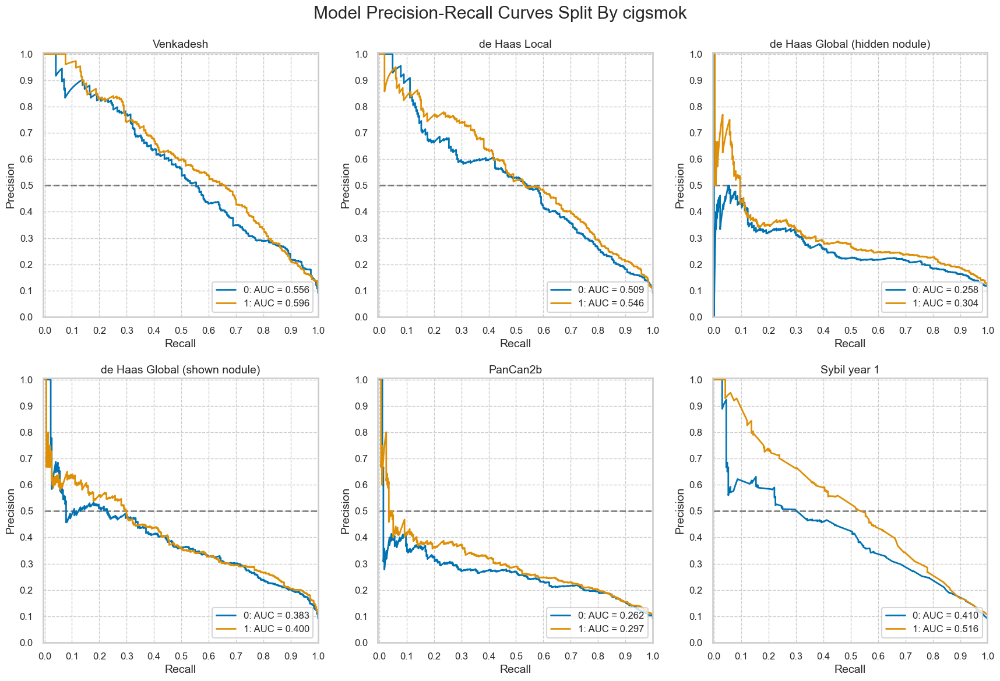

,num,pct,num_mal,pct_mal
0,2930,49.568601,267,9.112628
1,2981,50.431399,314,10.533378


Not binary: not computing significance test results.


#### pipe

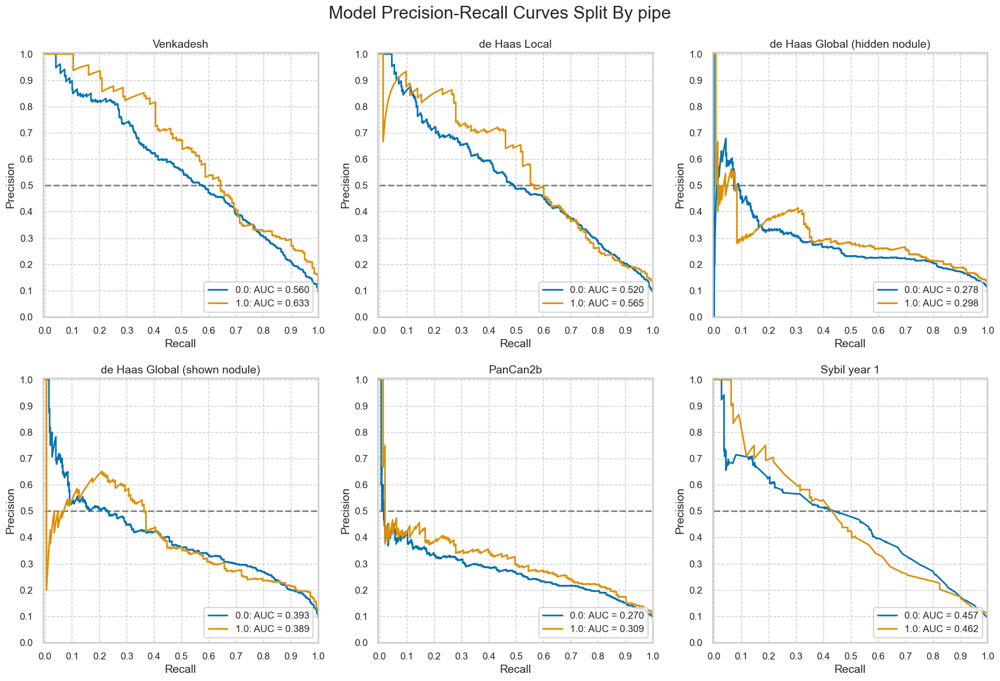

,num,pct,num_mal,pct_mal
0.0,4575,77.859088,436,9.530055
1.0,1301,22.140912,143,10.991545


Not binary: not computing significance test results.


#### smokelive

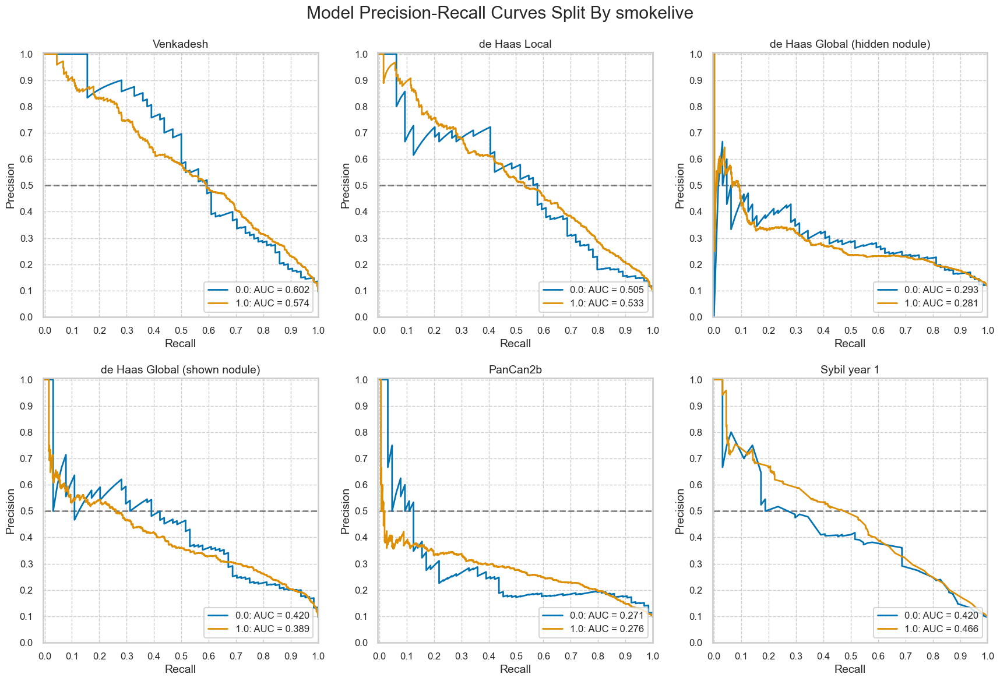

,num,pct,num_mal,pct_mal
0.0,665,11.317223,64,9.62406
1.0,5211,88.682777,514,9.86375


Not binary: not computing significance test results.


#### smokework

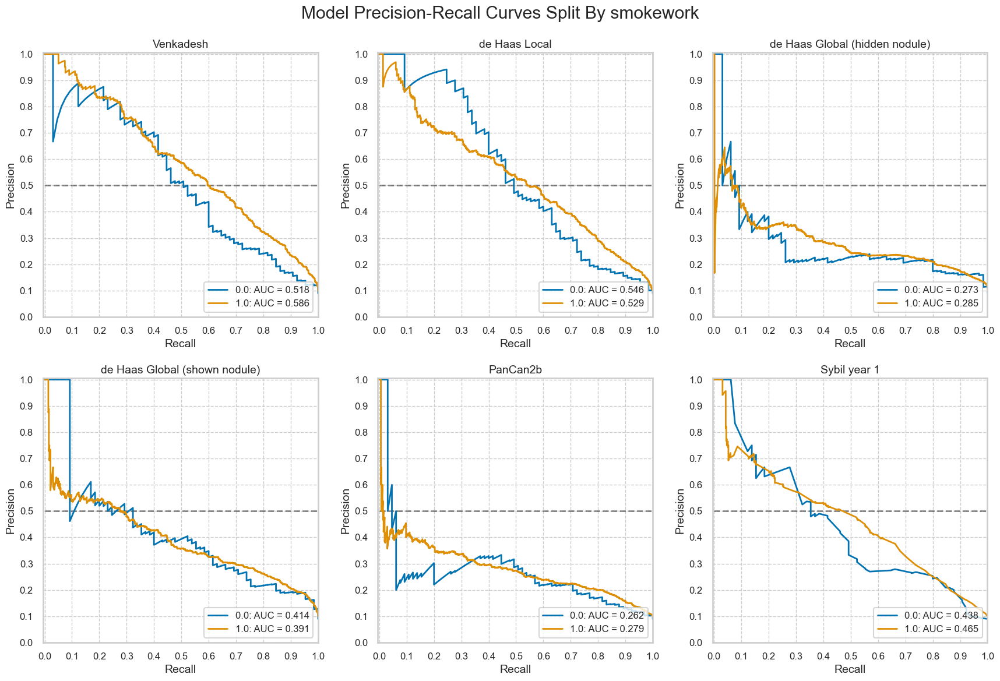

,num,pct,num_mal,pct_mal
0.0,722,12.314515,65,9.002770
1.0,5141,87.685485,512,9.959152


Not binary: not computing significance test results.


In [14]:
for cat in nlst_democols['cat']['smoke']:
    plot_by_category(nlst_preds, cat)

### Work history

#### wrkasbe

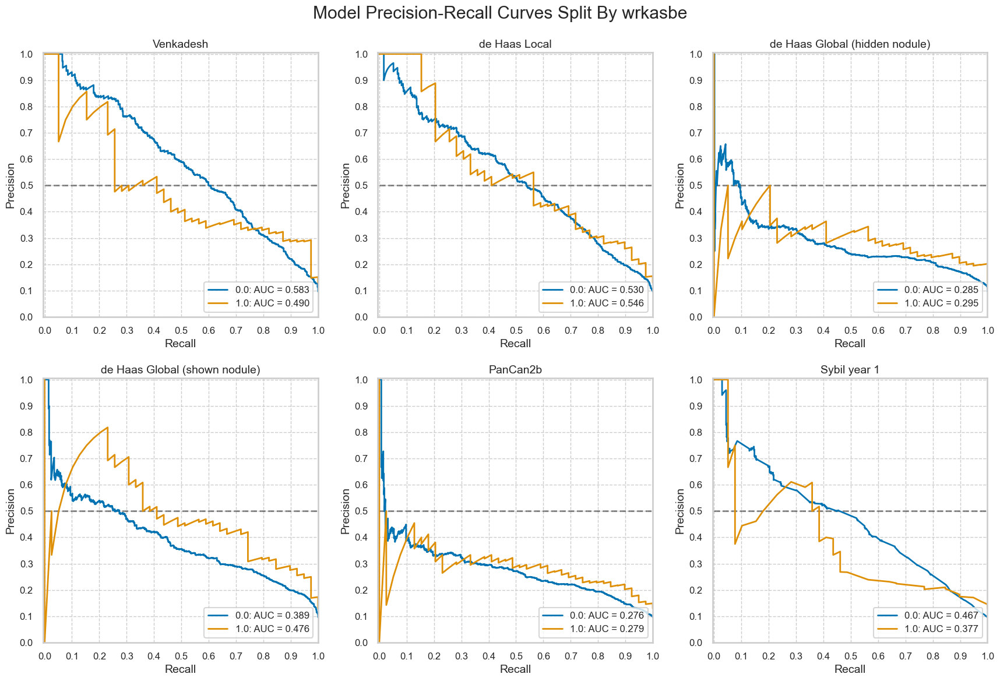

,num,pct,num_mal,pct_mal
0.0,5610,94.923858,541,9.643494
1.0,300,5.076142,39,13.000000


Not binary: not computing significance test results.


#### wrkbaki

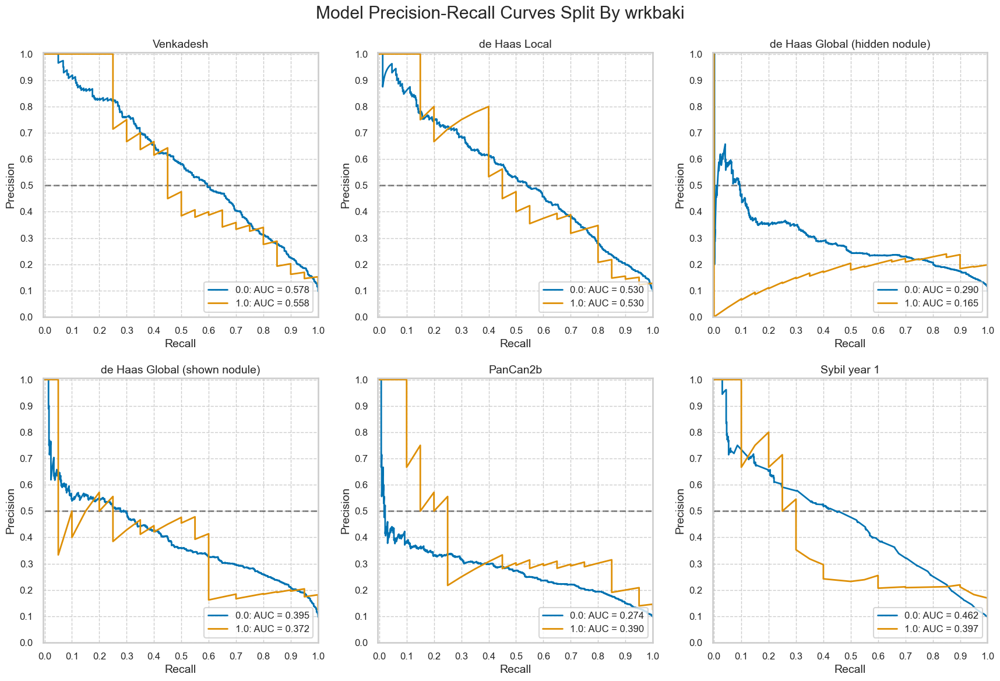

,num,pct,num_mal,pct_mal
0.0,5750,97.292724,560,9.73913
1.0,160,2.707276,20,12.50000


Not binary: not computing significance test results.


#### wrkbutc

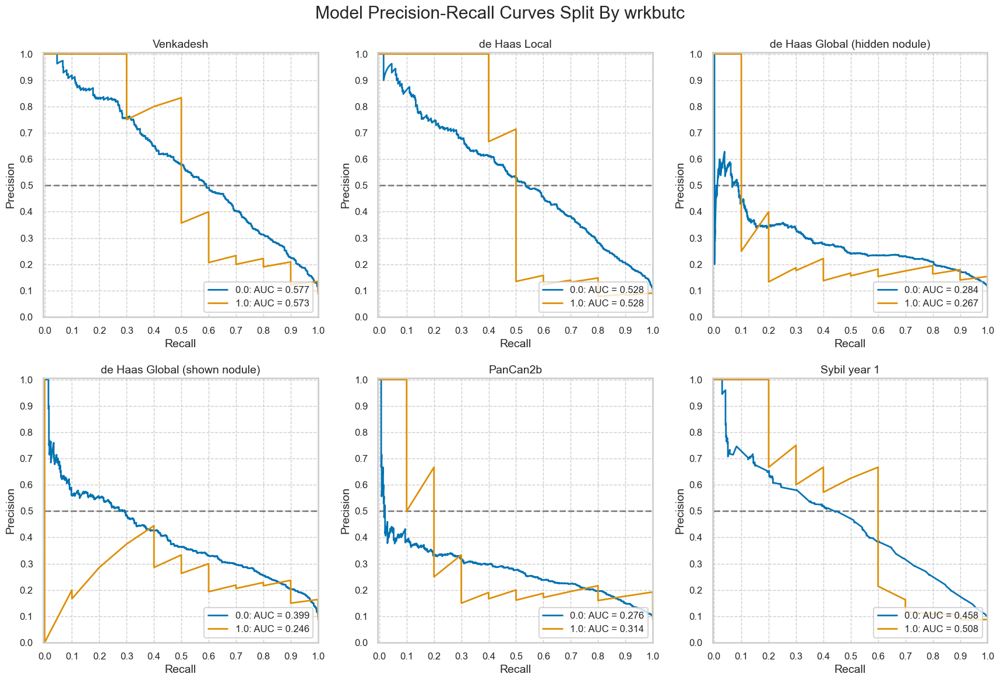

,num,pct,num_mal,pct_mal
0.0,5796,98.071066,570,9.834369
1.0,114,1.928934,10,8.771930


Not binary: not computing significance test results.


#### wrkchem

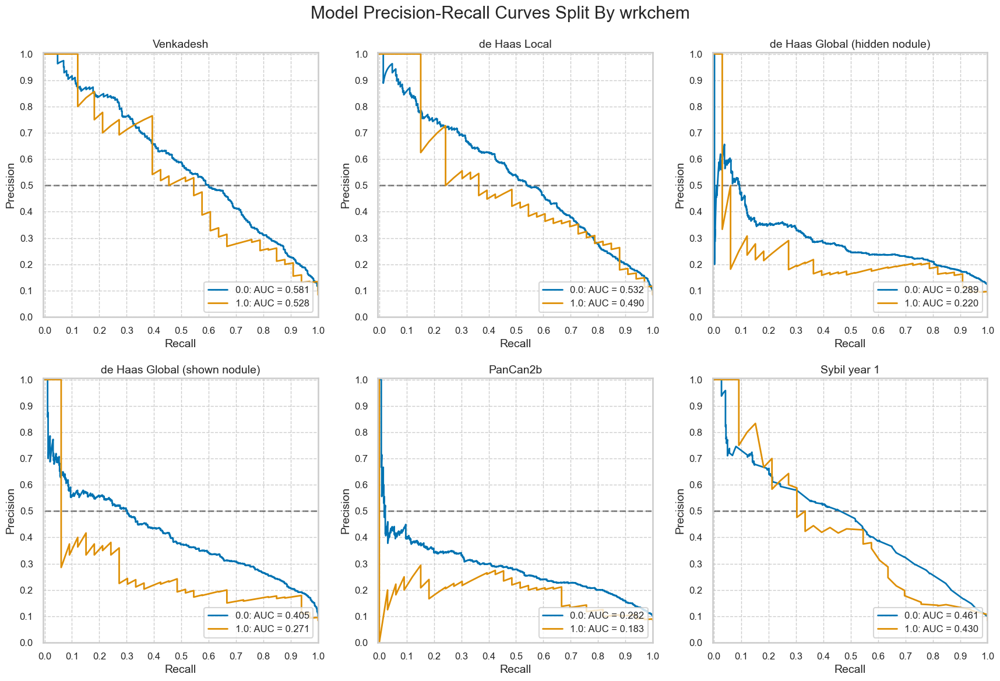

,num,pct,num_mal,pct_mal
0.0,5515,93.348003,547,9.918404
1.0,393,6.651997,33,8.396947


Not binary: not computing significance test results.


#### wrkcoal

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5888,99.62775,573,9.731658
1.0,22,0.37225,7,31.818182


Not binary: not computing significance test results.


#### wrkcott

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5858,99.120135,575,9.815637
1.0,52,0.879865,5,9.615385


Not binary: not computing significance test results.


#### wrkfarm

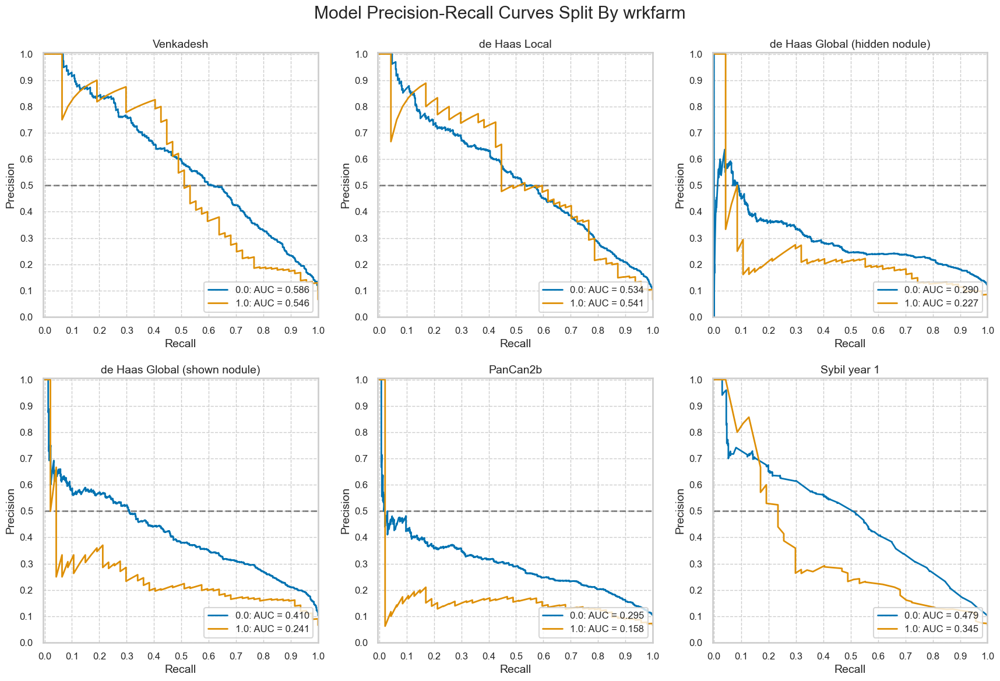

,num,pct,num_mal,pct_mal
0.0,5197,87.935702,533,10.255917
1.0,713,12.064298,47,6.591865


Not binary: not computing significance test results.


#### wrkfire

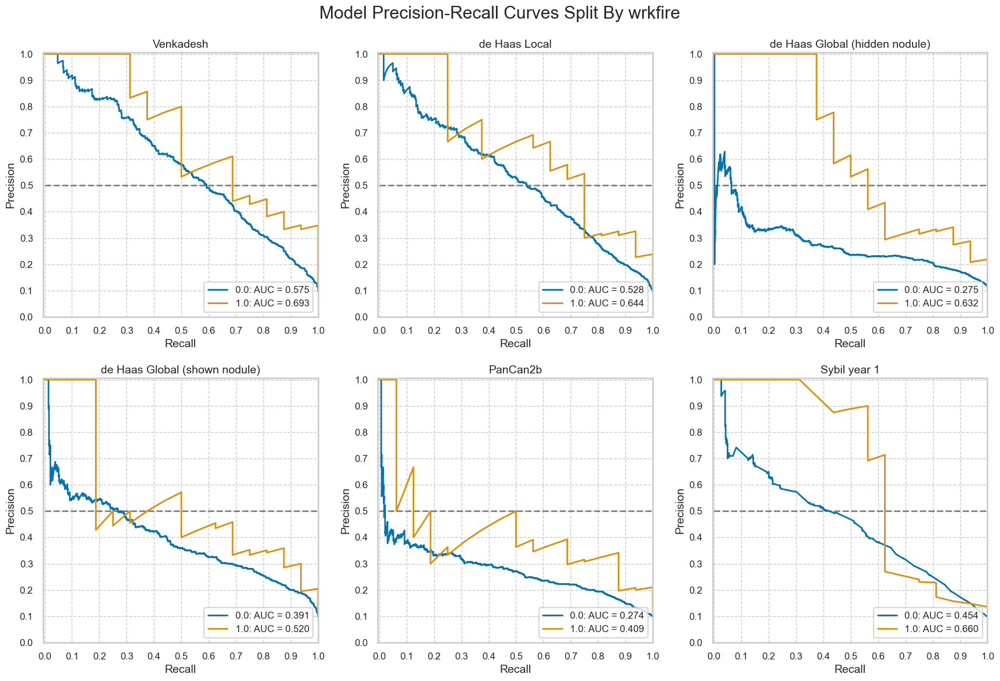

,num,pct,num_mal,pct_mal
0.0,5776,97.732657,564,9.764543
1.0,134,2.267343,16,11.940299


Not binary: not computing significance test results.


#### wrkflou

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5847,98.93401,573,9.799897
1.0,63,1.06599,7,11.111111


Not binary: not computing significance test results.


#### wrkfoun

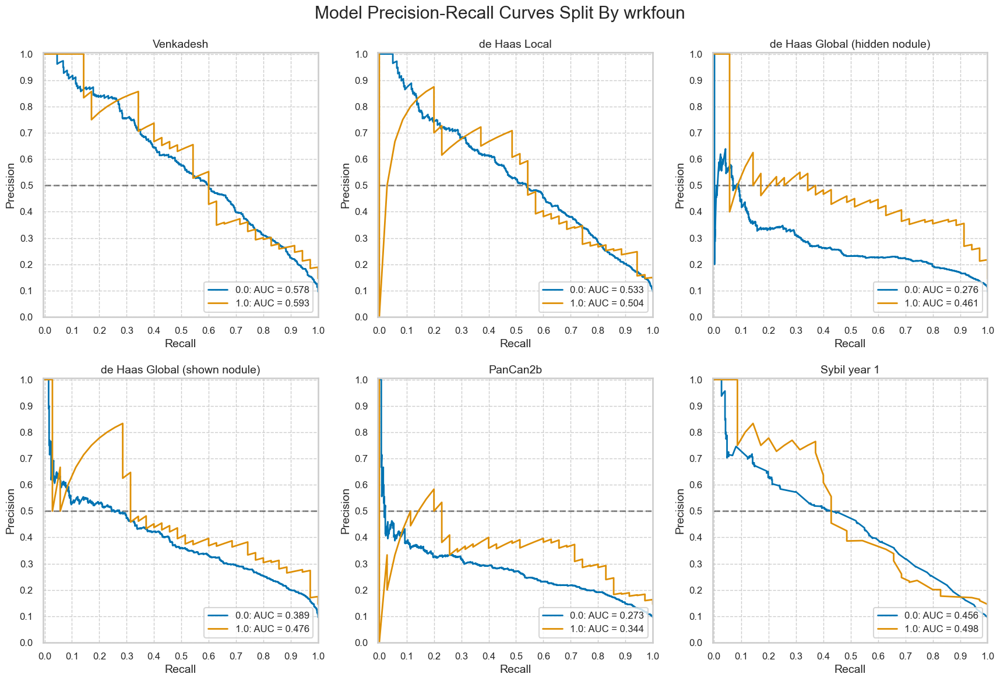

,num,pct,num_mal,pct_mal
0.0,5670,95.939086,545,9.611993
1.0,240,4.060914,35,14.583333


Not binary: not computing significance test results.


#### wrkhard

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5858,99.120135,579,9.883919
1.0,52,0.879865,1,1.923077


Not binary: not computing significance test results.


#### wrkpain

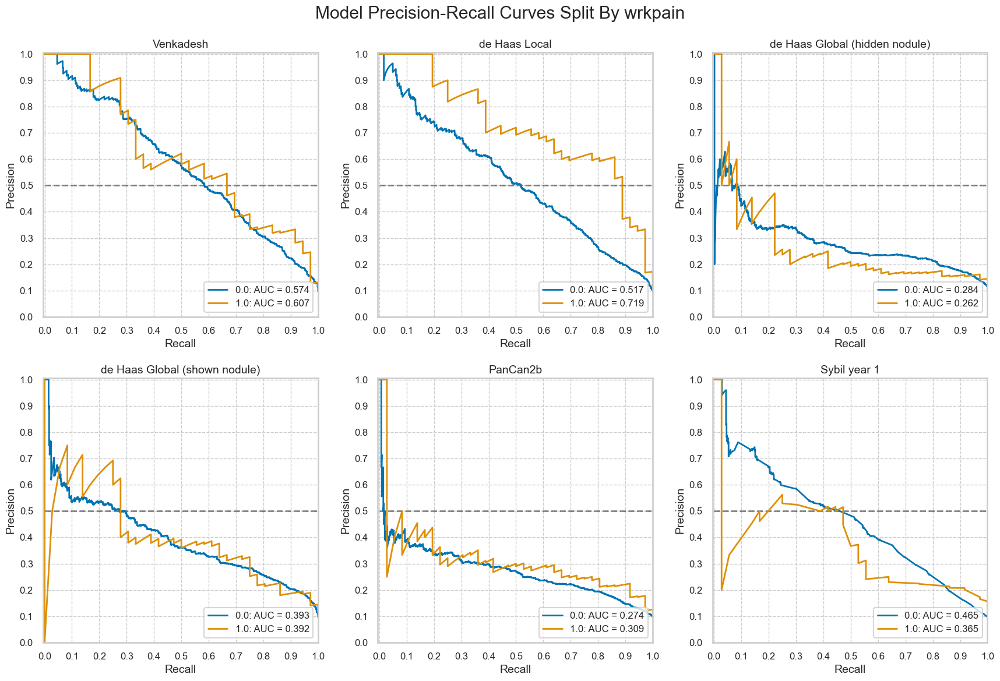

,num,pct,num_mal,pct_mal
0.0,5593,94.63621,544,9.726444
1.0,317,5.36379,36,11.356467


Not binary: not computing significance test results.


#### wrksand

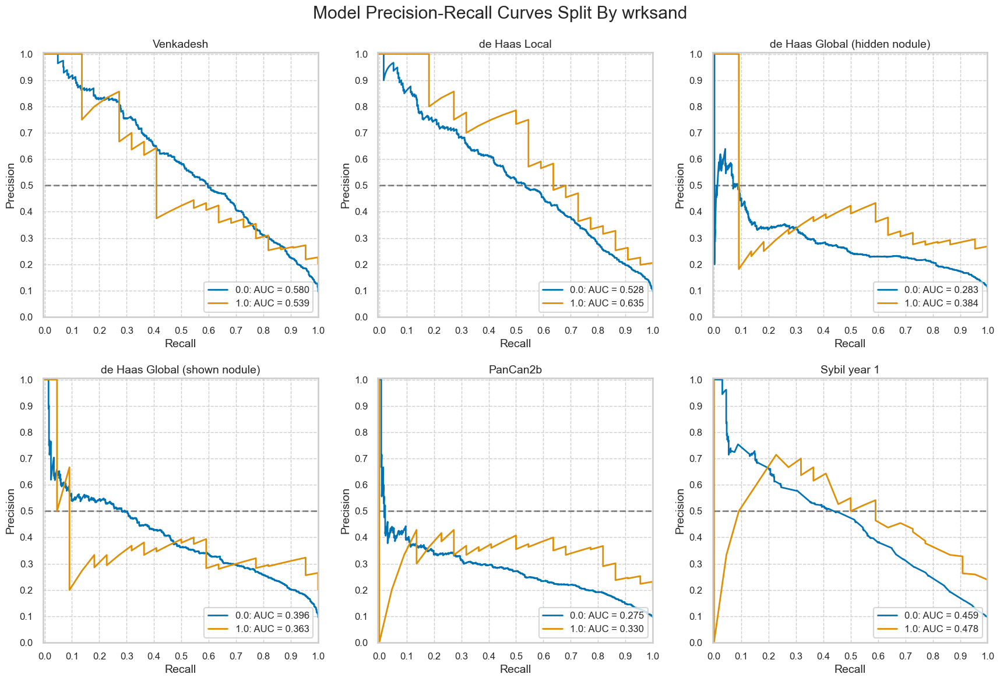

,num,pct,num_mal,pct_mal
0.0,5800,98.138748,558,9.62069
1.0,110,1.861252,22,20.00000


Not binary: not computing significance test results.


#### wrkweld

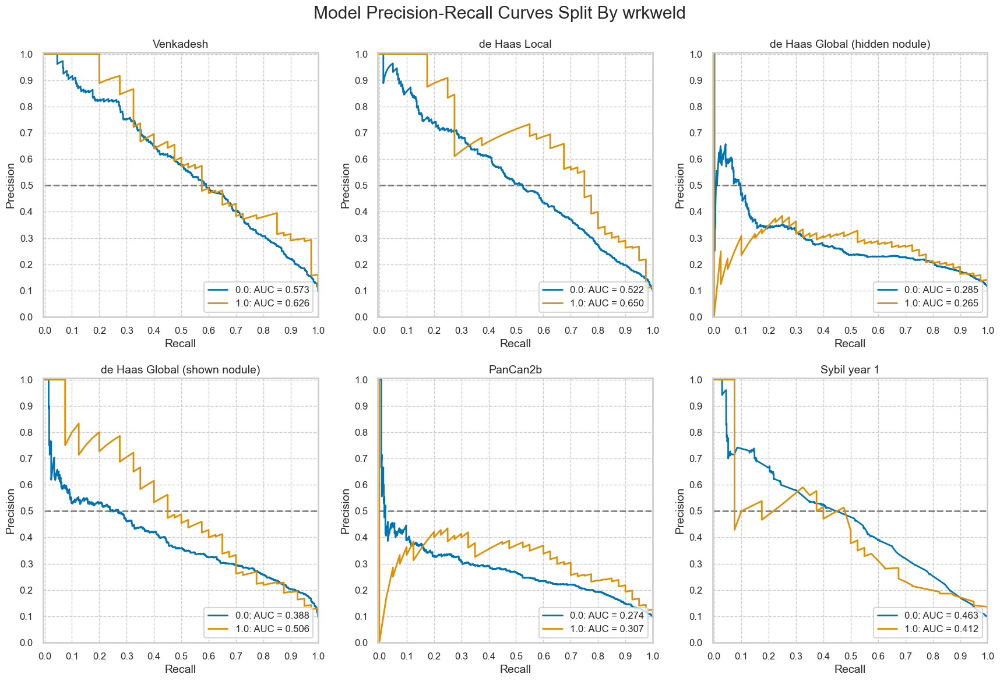

,num,pct,num_mal,pct_mal
0.0,5550,93.908629,540,9.729730
1.0,360,6.091371,40,11.111111


Not binary: not computing significance test results.


In [15]:
for cat in nlst_democols['cat']['work']:
    plot_by_category(nlst_preds, cat)

### Disease history

#### Emphysema

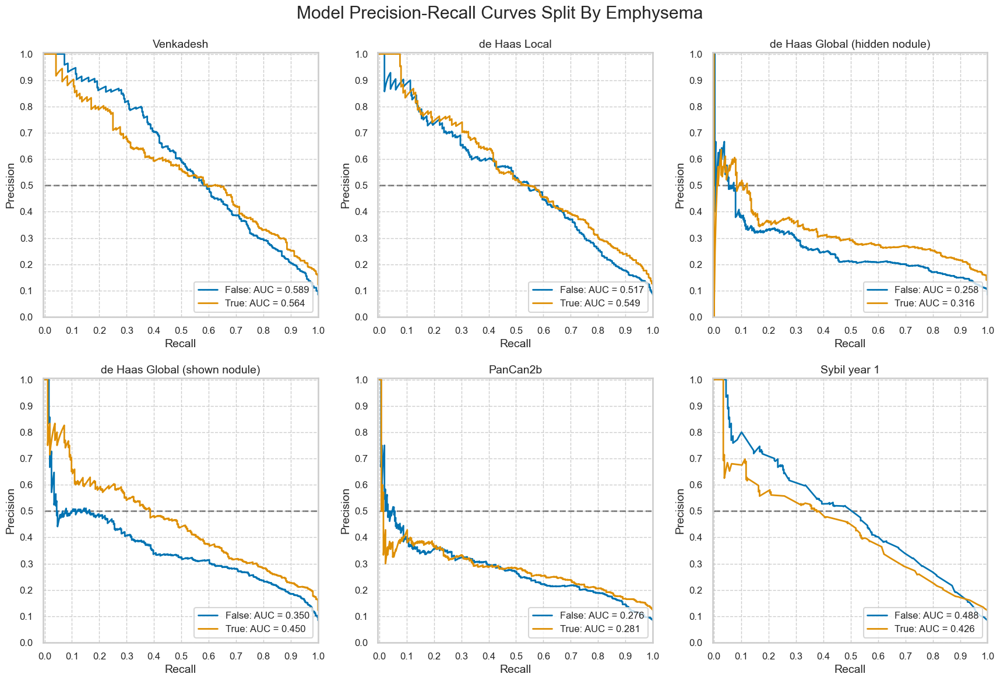

,num,pct,num_mal,pct_mal
False,3755,63.52563,317,8.442077
True,2156,36.47437,264,12.244898


Not binary: not computing significance test results.


In [16]:
plot_by_category(nlst_preds, 'Emphysema')

#### diagadas

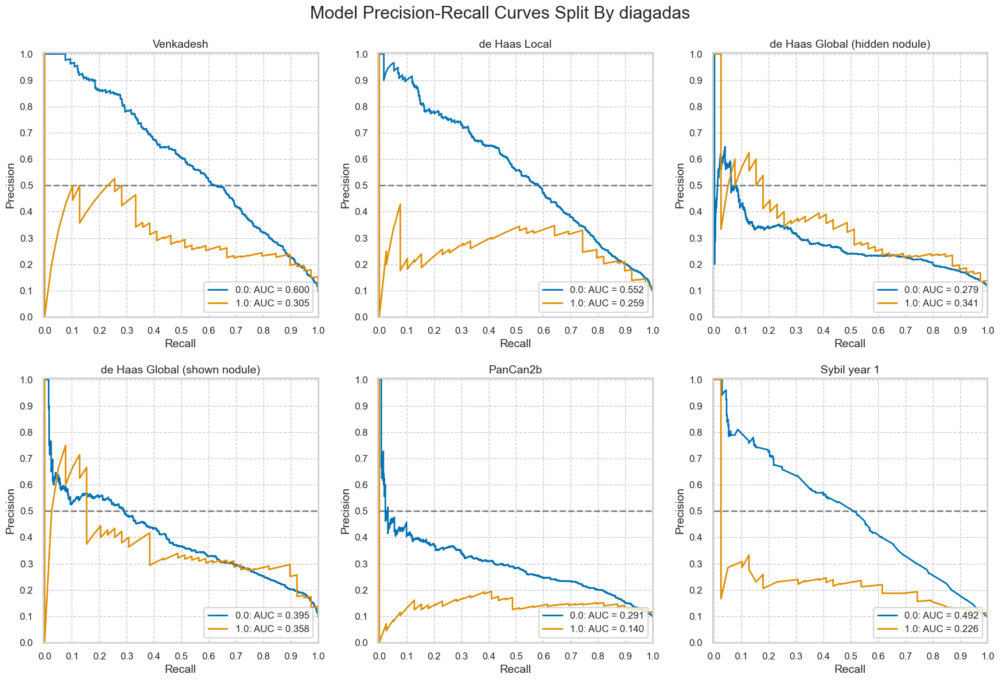

,num,pct,num_mal,pct_mal
0.0,5534,93.653749,541,9.775931
1.0,375,6.346251,39,10.400000


Not binary: not computing significance test results.


#### diagasbe

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5838,98.898865,572,9.797876
1.0,65,1.101135,8,12.307692


Not binary: not computing significance test results.


#### diagbron

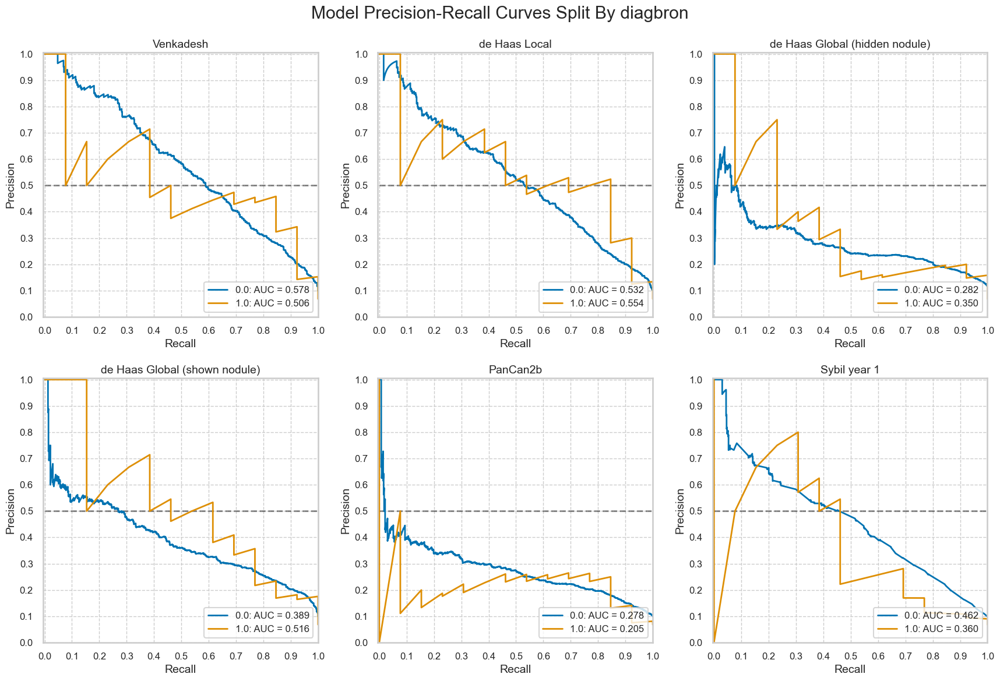

,num,pct,num_mal,pct_mal
0.0,5706,96.777476,564,9.884332
1.0,190,3.222524,13,6.842105


Not binary: not computing significance test results.


#### diagchas

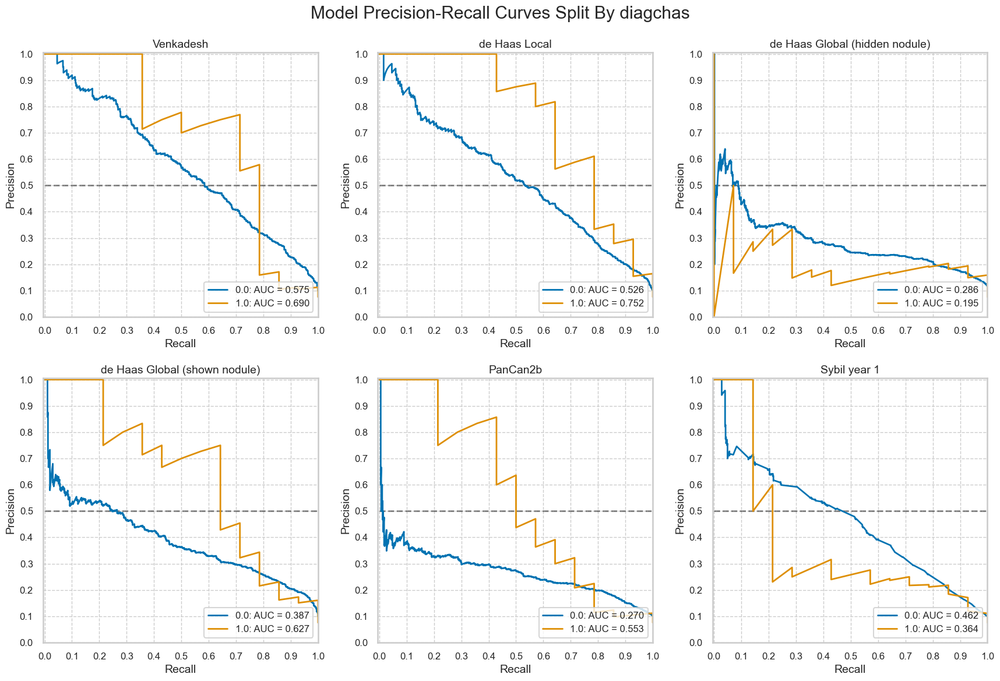

,num,pct,num_mal,pct_mal
0.0,5720,96.867062,566,9.895105
1.0,185,3.132938,14,7.567568


Not binary: not computing significance test results.


#### diagchro

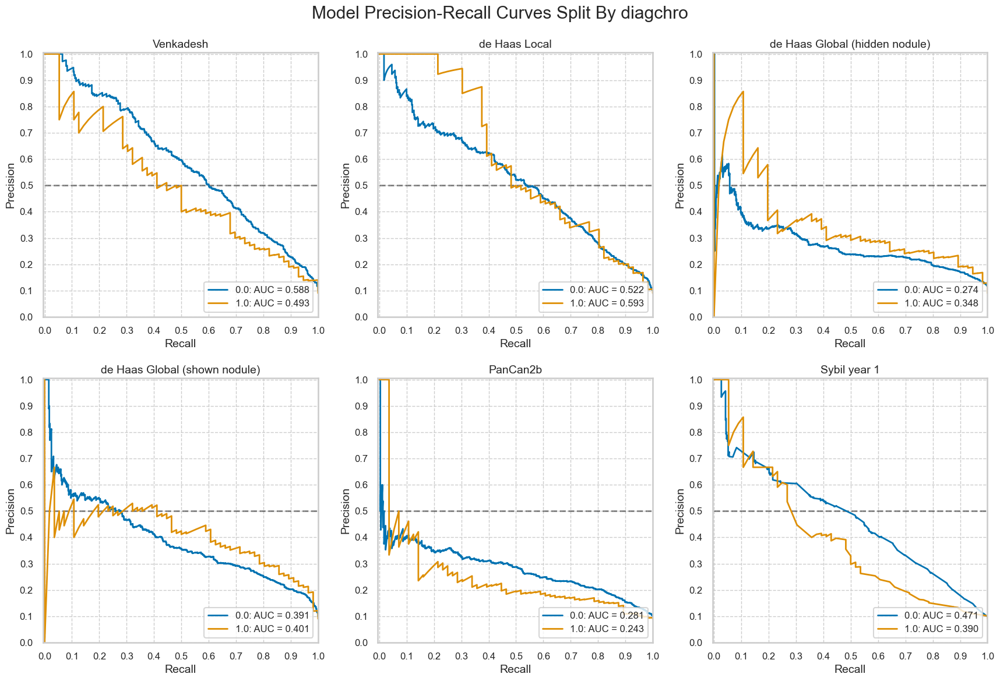

,num,pct,num_mal,pct_mal
0.0,5276,89.499576,521,9.874905
1.0,619,10.500424,56,9.046850


Not binary: not computing significance test results.


#### diagcopd

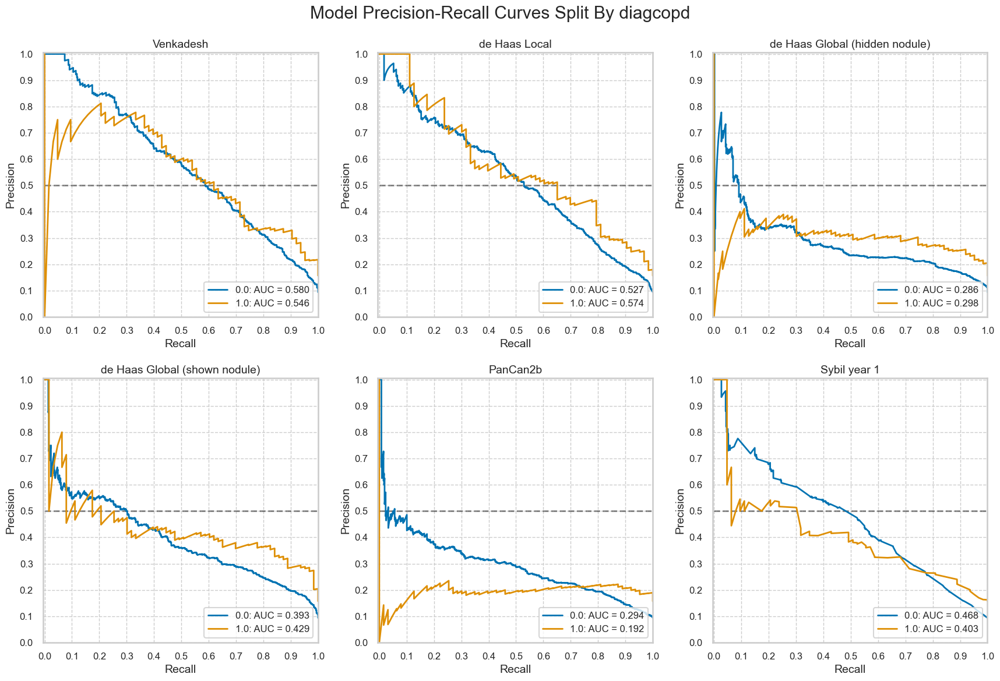

,num,pct,num_mal,pct_mal
0.0,5492,93.195316,516,9.395484
1.0,401,6.804684,63,15.710723


Not binary: not computing significance test results.


#### diagdiab

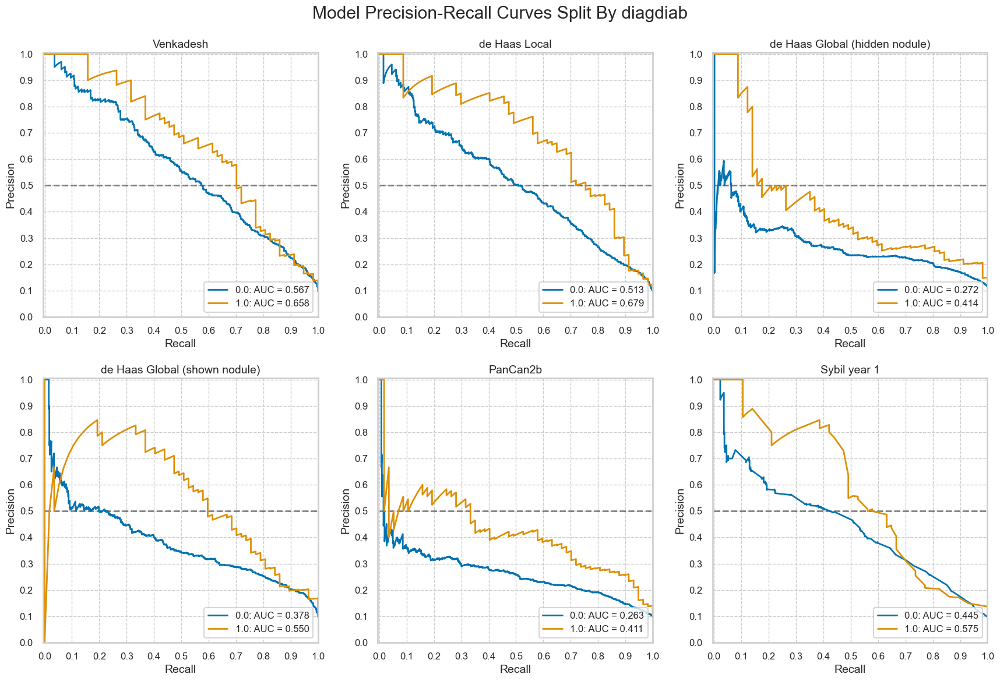

,num,pct,num_mal,pct_mal
0.0,5362,90.773658,523,9.753823
1.0,545,9.226342,57,10.458716


Not binary: not computing significance test results.


#### diagemph

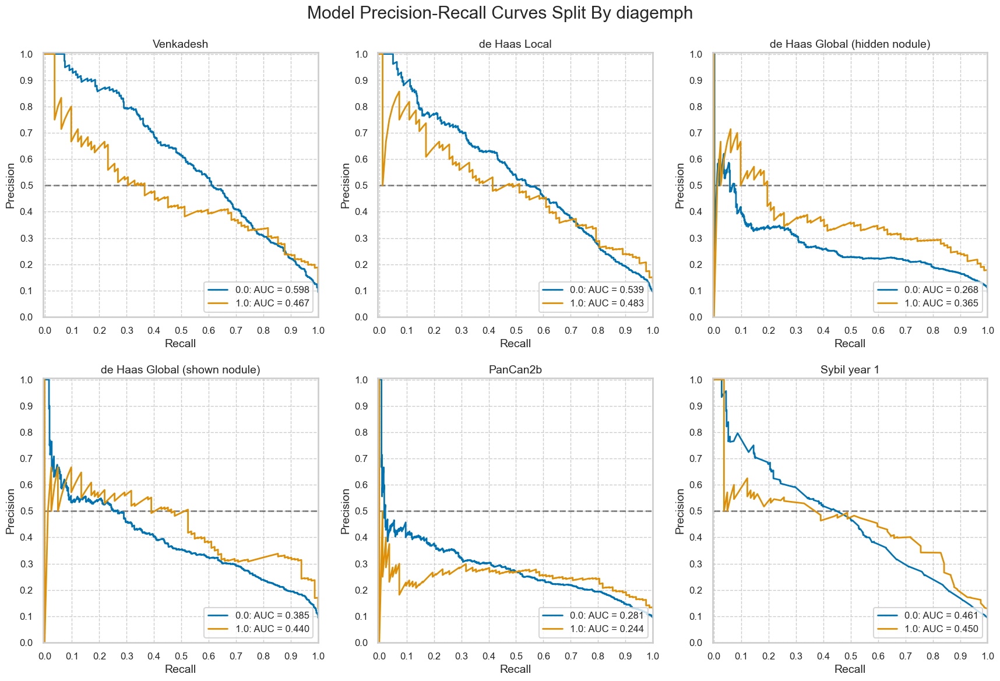

,num,pct,num_mal,pct_mal
0.0,5265,89.237288,497,9.439696
1.0,635,10.762712,82,12.913386


Not binary: not computing significance test results.


#### diagfibr

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5887,99.762752,578,9.818244
1.0,14,0.237248,2,14.285714


Not binary: not computing significance test results.


#### diaghear

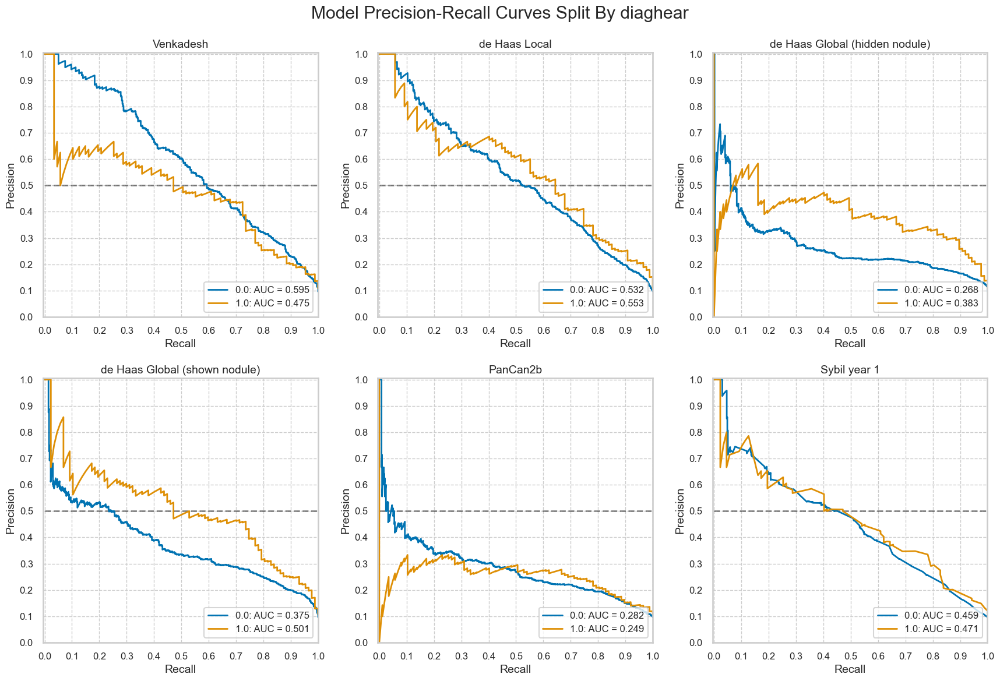

,num,pct,num_mal,pct_mal
0.0,5087,86.381389,492,9.671712
1.0,802,13.618611,87,10.847880


Not binary: not computing significance test results.


#### diaghype

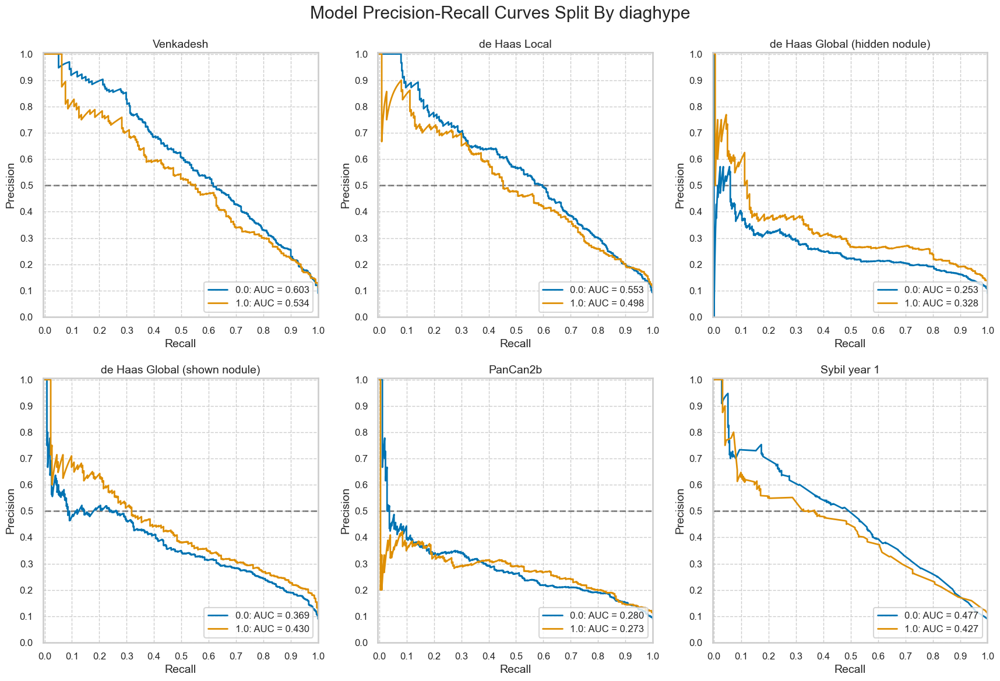

,num,pct,num_mal,pct_mal
0.0,3909,66.231786,352,9.004861
1.0,1993,33.768214,223,11.189162


Not binary: not computing significance test results.


#### diagpneu

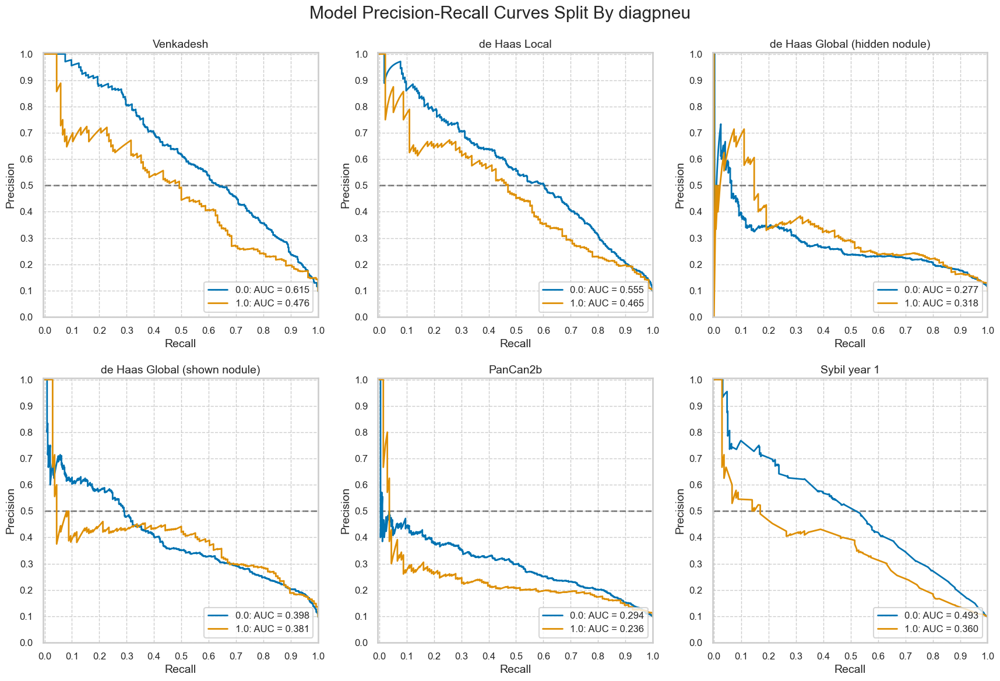

,num,pct,num_mal,pct_mal
0.0,4514,76.56038,438,9.703146
1.0,1382,23.43962,136,9.840810


Not binary: not computing significance test results.


#### diagsarc

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5889,99.83048,576,9.780948
1.0,10,0.16952,2,20.000000


Not binary: not computing significance test results.


#### diagsili

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5887,99.796576,574,9.750297
1.0,12,0.203424,4,33.333333


Not binary: not computing significance test results.


#### diagstro

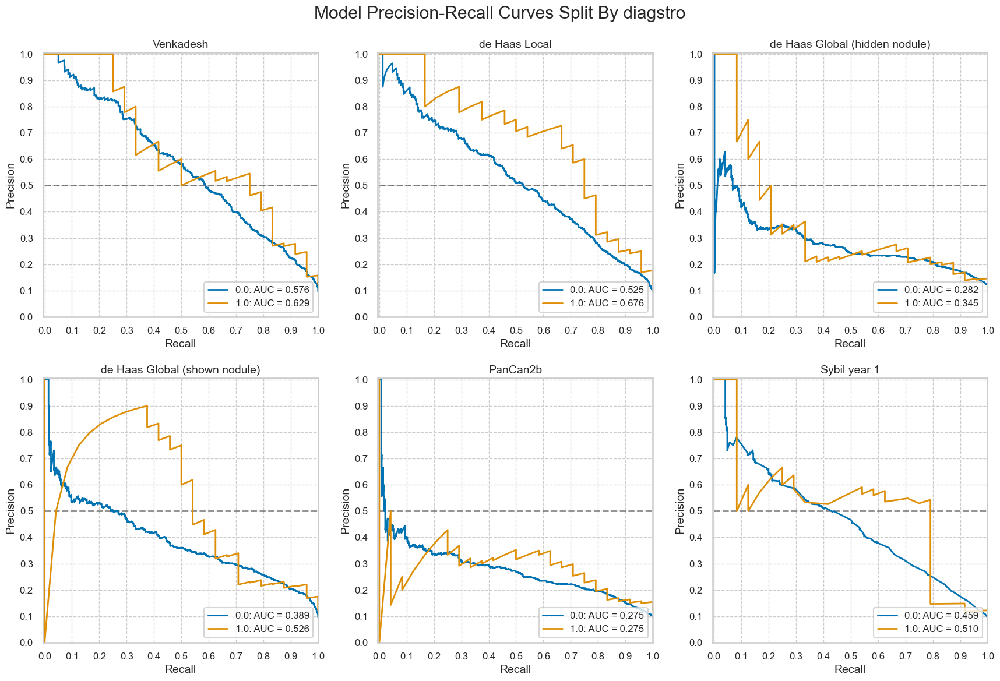

,num,pct,num_mal,pct_mal
0.0,5710,96.681341,556,9.737303
1.0,196,3.318659,24,12.244898


Not binary: not computing significance test results.


#### diagtube

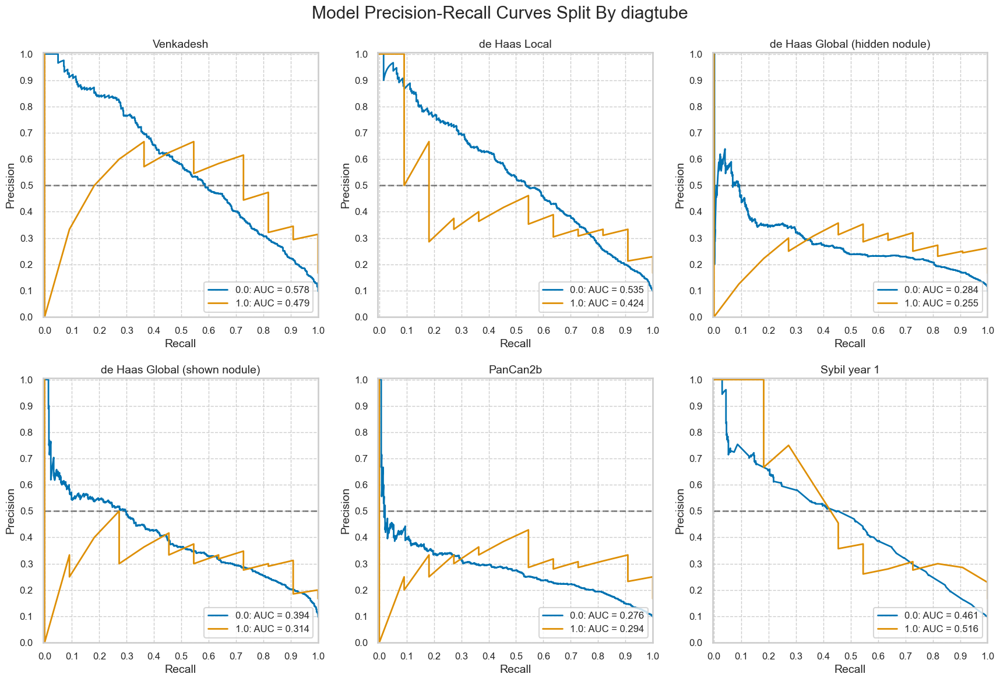

,num,pct,num_mal,pct_mal
0.0,5839,98.882303,569,9.744819
1.0,66,1.117697,11,16.666667


Not binary: not computing significance test results.


In [17]:
for cat in nlst_democols['cat']['disease']:
    plot_by_category(nlst_preds, cat)

### Previous cancer history

#### cancblad

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5865,99.373094,575,9.803922
1.0,37,0.626906,2,5.405405


Not binary: not computing significance test results.


#### cancbrea

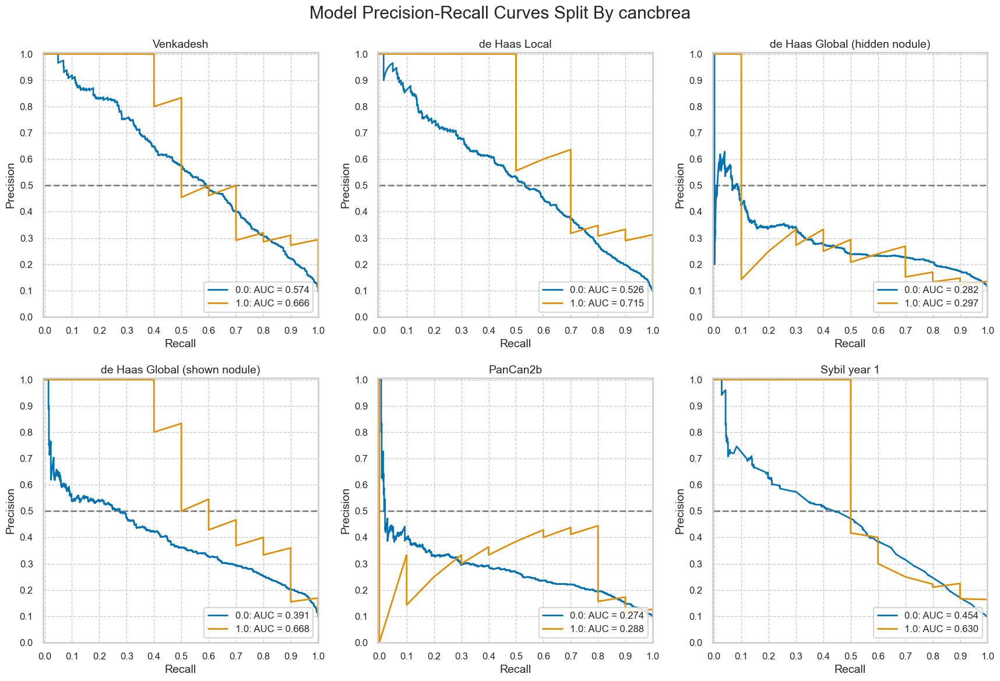

,num,pct,num_mal,pct_mal
0.0,5807,98.40705,567,9.764078
1.0,94,1.59295,10,10.638298


Not binary: not computing significance test results.


#### canccerv

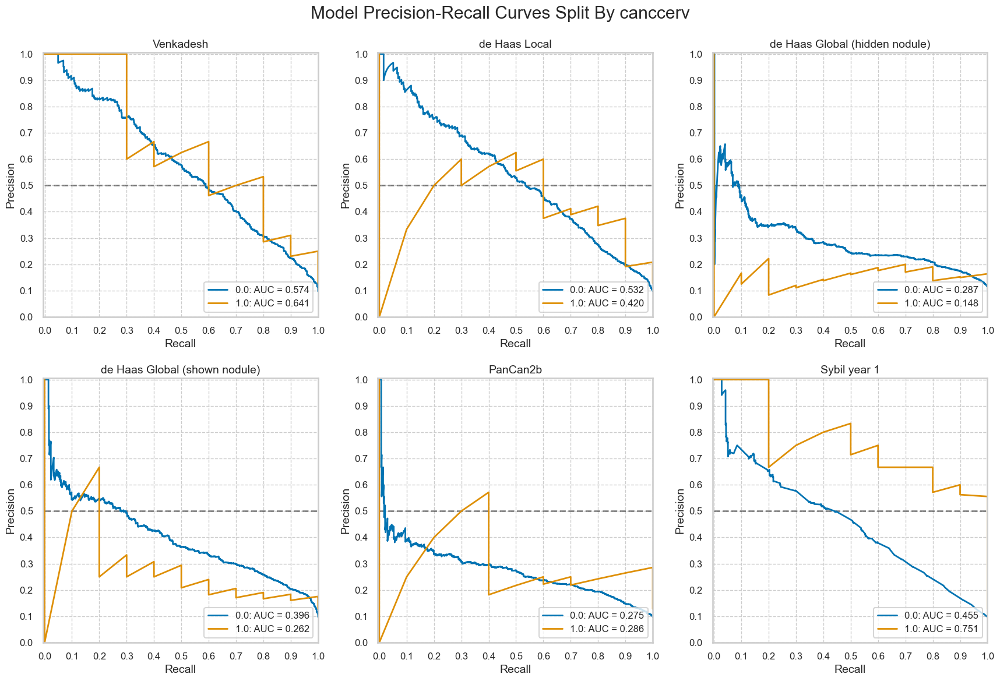

,num,pct,num_mal,pct_mal
0.0,5823,98.67819,567,9.737249
1.0,78,1.32181,10,12.820513


Not binary: not computing significance test results.


#### canccolo

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5871,99.457903,575,9.793902
1.0,32,0.542097,2,6.250000


Not binary: not computing significance test results.


#### cancesop

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5896,99.881416,577,9.786296
1.0,7,0.118584,0,0.000000


Not binary: not computing significance test results.


#### canckidn

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5893,99.830595,576,9.774309
1.0,10,0.169405,1,10.000000


Not binary: not computing significance test results.


#### canclary

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5895,99.864476,576,9.770992
1.0,8,0.135524,1,12.500000


Not binary: not computing significance test results.


#### canclung

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5902,99.983059,577,9.776347
1.0,1,0.016941,0,0.000000


Not binary: not computing significance test results.


#### cancnasa

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5896,99.881416,576,9.769335
1.0,7,0.118584,1,14.285714


Not binary: not computing significance test results.


#### cancoral

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5896,99.89834,575,9.752374
1.0,6,0.10166,2,33.333333


Not binary: not computing significance test results.


#### cancpanc

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5903,100.0,577,9.774691


Not binary: not computing significance test results.


#### cancphar

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5900,99.949178,577,9.779661
1.0,3,0.050822,0,0.000000


Not binary: not computing significance test results.


#### cancstom

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5895,99.864476,577,9.787956
1.0,8,0.135524,0,0.000000


Not binary: not computing significance test results.


#### cancthyr

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5896,99.932203,576,9.769335
1.0,4,0.067797,1,25.000000


Not binary: not computing significance test results.


#### canctran

Less than two groups. SKIP


,num,pct,num_mal,pct_mal
0.0,5901,99.983057,575,9.744111
1.0,1,0.016943,1,100.000000


Not binary: not computing significance test results.


In [18]:
for cat in nlst_democols['cat']['canchist']:
    plot_by_category(nlst_preds, cat)

## Binning for numerical columns

### Demographic columns

#### height

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5322.0,67.992108,3.975060,53.0,65.0,68.0,71.0,83.0
1,579.0,67.867012,3.938709,59.0,65.0,68.0,71.0,76.0


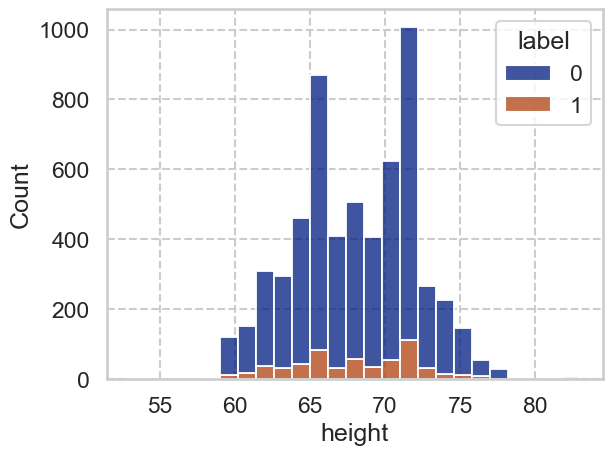

#### weight

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5323.0,182.510802,39.453415,75.0,155.0,180.0,205.0,368.0
1,575.0,176.481739,36.847637,95.0,150.0,175.0,200.0,322.0


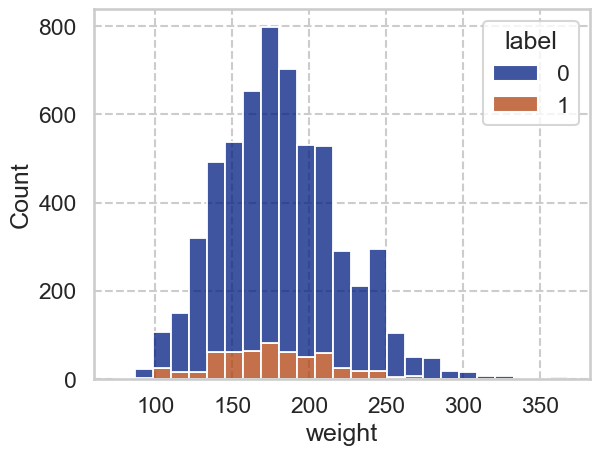

#### Age

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,63.088180,5.263707,54.0,59.0,62.0,67.0,76.0
1,581.0,64.061962,5.202746,55.0,60.0,64.0,68.0,76.0


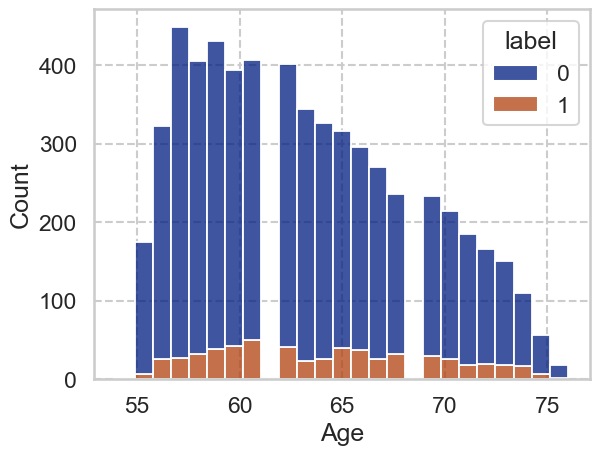

#### BMI

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5318.0,27.63764,4.984482,13.284203,24.209972,27.005931,30.550293,57.630653
1,574.0,26.79225,4.402291,16.432432,24.207989,26.172647,29.049587,47.587692


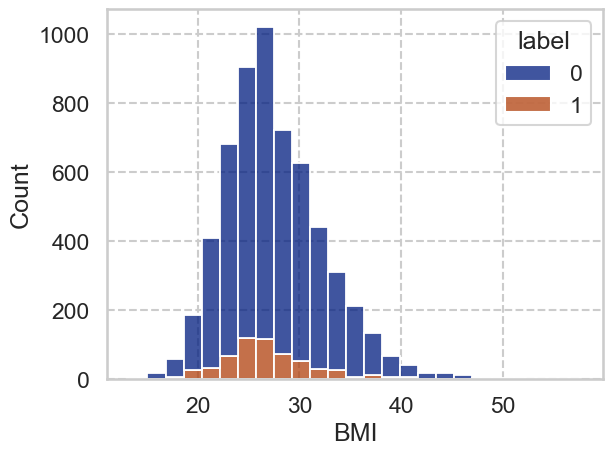

In [19]:
for c in nlst_democols['num']['demo']:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\33758728.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                               height  \
                 count      mean       std  min  25%  50%  75%  max   count   
bin_height                                                                    
(52.999, 68.0]  3134.0  0.099553  0.299451  0.0  0.0  0.0  0.0  1.0  3134.0   
(68.0, 83.0]    2767.0  0.096494  0.295321  0.0  0.0  0.0  0.0  1.0  2767.0   

                                                                   
                     mean       std   min   25%   50%   75%   max  
bin_height                                                         
(52.999, 68.0]  64.869177  2.355045  53.0  63.0  65.0  67.0  68.0  
(68.0, 83.0]    71.503072  1.994545  69.0  70.0  71.0  73.0  83.0

#### bin_height

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


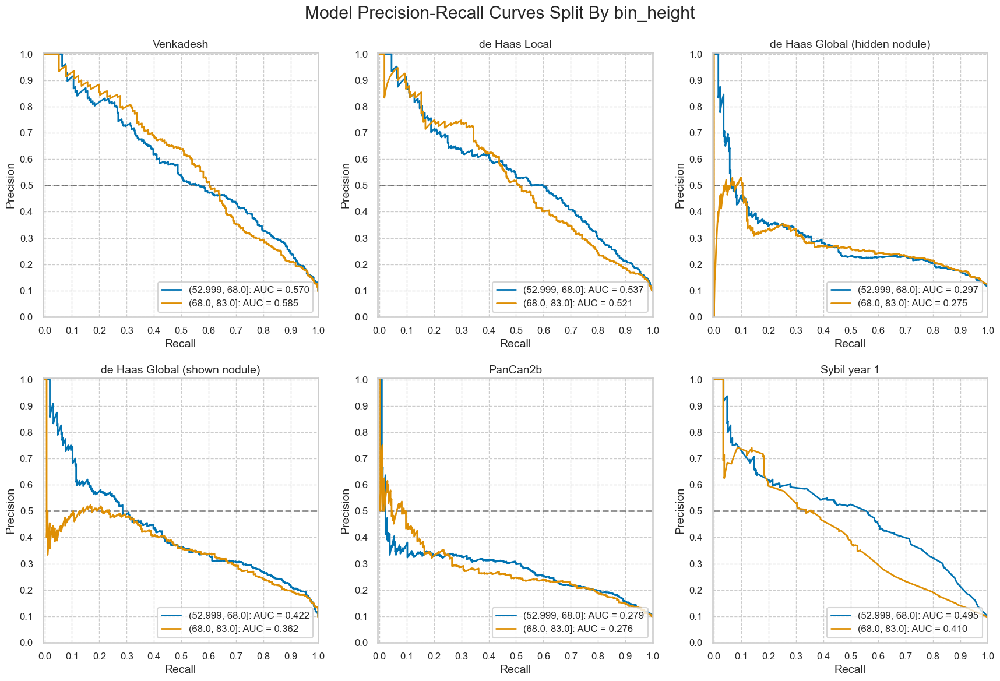

,num,pct,num_mal,pct_mal
"(52.999, 68.0]",3134,53.109642,312,9.955329
"(68.0, 83.0]",2767,46.890358,267,9.649440


Not binary: not computing significance test results.


C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\33758728.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                               weight  \
                  count      mean       std  min  25%  50%  75%  max   count   
bin_weight                                                                     
(74.999, 180.0]  3082.0  0.106424  0.308430  0.0  0.0  0.0  0.0  1.0  3082.0   
(180.0, 368.0]   2816.0  0.087713  0.282927  0.0  0.0  0.0  0.0  1.0  2816.0   

                                                                           
                       mean        std    min    25%    50%    75%    max  
bin_weight                                                                 
(74.999, 180.0]  152.228423  20.400591   75.0  139.0  155.0  170.0  180.0  
(180.0, 368.0]   214.422585  27.365632  181.0  193.0  208.0  230.0  368.0

#### bin_weight

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


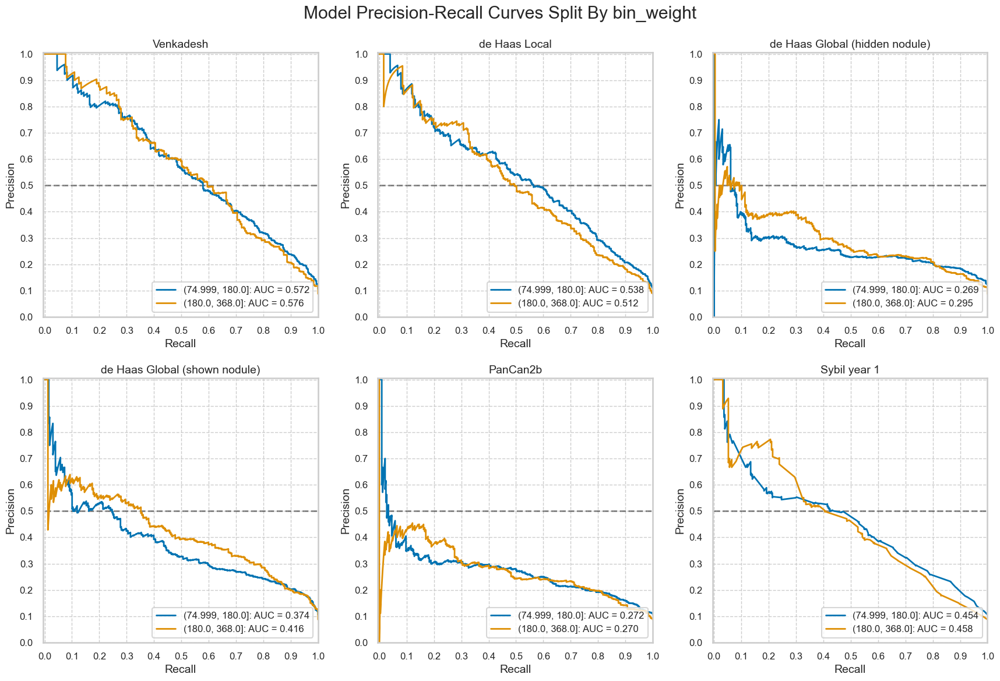

,num,pct,num_mal,pct_mal
"(74.999, 180.0]",3082,52.255002,328,10.642440
"(180.0, 368.0]",2816,47.744998,247,8.771307


Not binary: not computing significance test results.


C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\33758728.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                                  Age  \
                 count      mean       std  min  25%  50%  75%  max   count   
bin_Age                                                                       
(53.999, 62.0]  2988.0  0.088353  0.283856  0.0  0.0  0.0  0.0  1.0  2988.0   
(62.0, 76.0]    2923.0  0.108450  0.311001  0.0  0.0  0.0  0.0  1.0  2923.0   

                                                                   
                     mean       std   min   25%   50%   75%   max  
bin_Age                                                            
(53.999, 62.0]  58.811245  2.123374  54.0  57.0  59.0  61.0  62.0  
(62.0, 76.0]    67.653780  3.453298  63.0  65.0  67.0  70.0  76.0

#### bin_Age

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


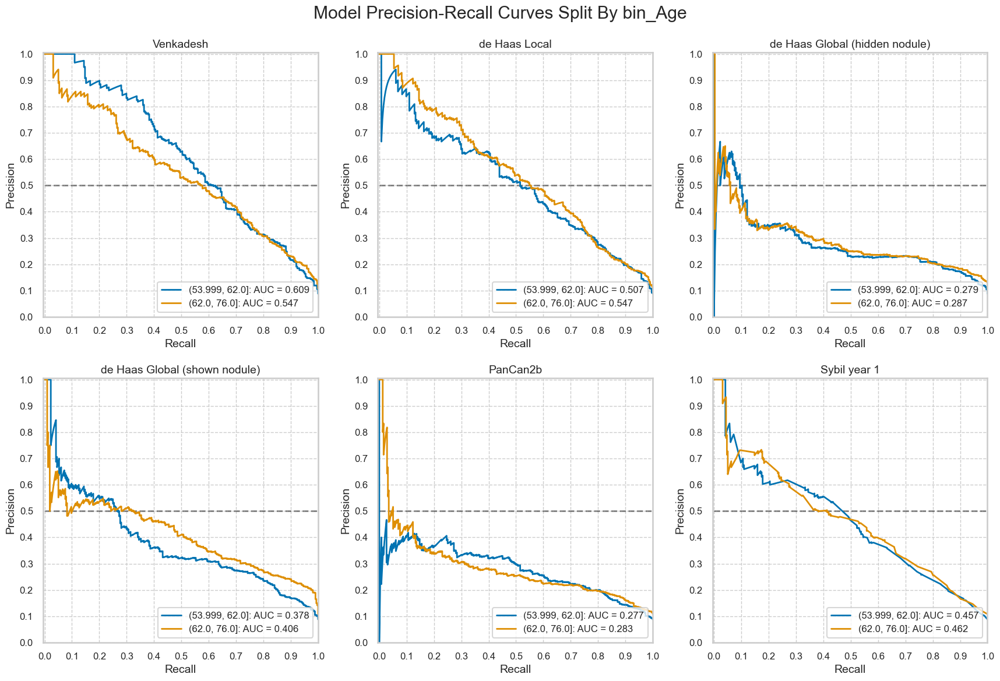

,num,pct,num_mal,pct_mal
"(53.999, 62.0]",2988,50.549822,264,8.835341
"(62.0, 76.0]",2923,49.450178,317,10.845022


Not binary: not computing significance test results.


C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\33758728.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                          \
                              count      mean       std  min  25%  50%  75%   
bin_BMI                                                                       
(13.283000000000001, 26.87]  2956.0  0.112314  0.315806  0.0  0.0  0.0  0.0   
(26.87, 57.631]              2936.0  0.082425  0.275058  0.0  0.0  0.0  0.0   

                                     BMI                                  \
                             max   count       mean       std        min   
bin_BMI                                                                    
(13.283000000000001, 26.87]  1.0  2956.0  23.753599  2.257101  13.284203   
(26.87, 57.631]              1.0  2936.0  31.382861  3.818099  26.873766   

                                                                         
                                   25%        50%        75%        max  
bin_BMI                                                                  
(13.283000000000001, 26.87]  22.312778  24.207989  25.603538  26.870222  
(26.87, 57.631]              28.478009  30.406574  33.190637  57.630653

#### bin_BMI

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


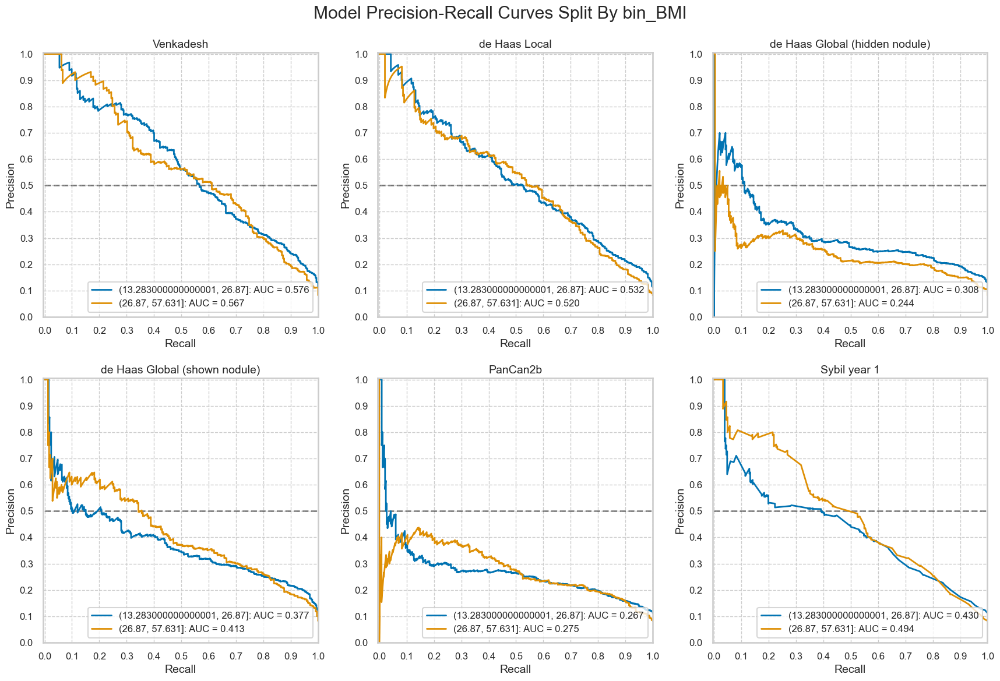

,num,pct,num_mal,pct_mal
"(13.283000000000001, 26.87]",2956,50.169722,332,11.231394
"(26.87, 57.631]",2936,49.830278,242,8.242507


Not binary: not computing significance test results.


In [20]:
for c in nlst_democols['num']['demo']:
    nlst_preds[f'bin_{c}'] = pd.qcut(nlst_preds[c], q=2)
    display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())
    plot_by_category(nlst_preds, f'bin_{c}')

C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\4236575594.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby('bin_height')[['label', 'height']].describe())


label                                               height  \
             count      mean       std  min  25%  50%  75%  max   count   
bin_height                                                                
(48, 68]    3134.0  0.099553  0.299451  0.0  0.0  0.0  0.0  1.0  3134.0   
(68, 88]    2767.0  0.096494  0.295321  0.0  0.0  0.0  0.0  1.0  2767.0   

                                                               
                 mean       std   min   25%   50%   75%   max  
bin_height                                                     
(48, 68]    64.869177  2.355045  53.0  63.0  65.0  67.0  68.0  
(68, 88]    71.503072  1.994545  69.0  70.0  71.0  73.0  83.0

#### bin_height

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


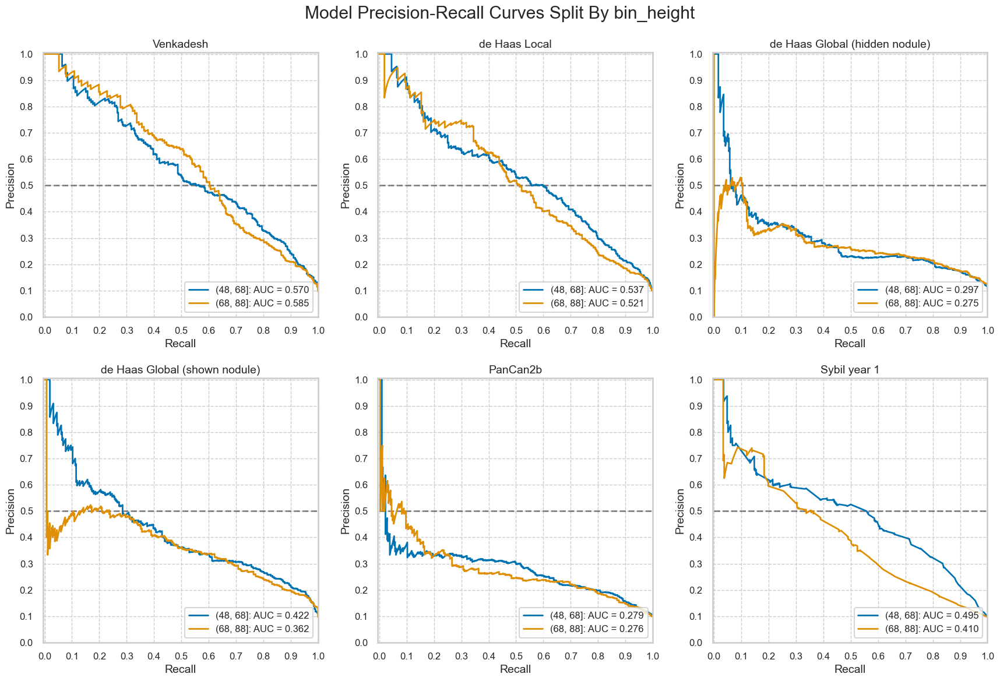

,num,pct,num_mal,pct_mal
"(48, 68]",3134,53.109642,312,9.955329
"(68, 88]",2767,46.890358,267,9.649440


Not binary: not computing significance test results.


In [21]:
nlst_preds['bin_height'] = pd.cut(nlst_preds['height'], bins=[48, 68, 88], right=True)
display(nlst_preds.groupby('bin_height')[['label', 'height']].describe())
plot_by_category(nlst_preds, f'bin_height')

C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\214614611.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby('bin_weight')[['label', 'weight']].describe())


label                                               weight  \
             count      mean       std  min  25%  50%  75%  max   count   
bin_weight                                                                
(79, 179]   2855.0  0.105779  0.307609  0.0  0.0  0.0  0.0  1.0  2855.0   
(179, 279]  2961.0  0.091523  0.288400  0.0  0.0  0.0  0.0  1.0  2961.0   

                                                                     
                 mean        std    min    25%    50%    75%    max  
bin_weight                                                           
(79, 179]   150.09387  19.487052   88.0  137.0  154.0  165.0  179.0  
(179, 279]  209.49409  23.817196  180.0  190.0  204.0  225.0  279.0

#### bin_weight

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


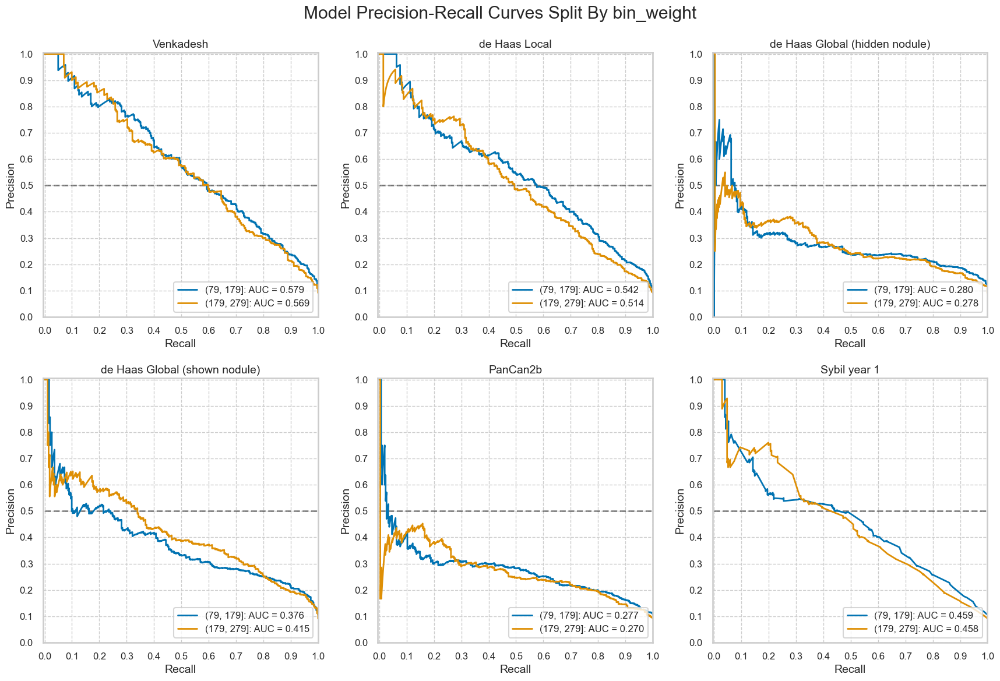

,num,pct,num_mal,pct_mal
"(79, 179]",2855,49.088721,302,10.577933
"(179, 279]",2961,50.911279,271,9.152313


Not binary: not computing significance test results.


In [22]:
nlst_preds['bin_weight'] = pd.cut(nlst_preds['weight'], bins=[79, 179, 279], right=True)
display(nlst_preds.groupby('bin_weight')[['label', 'weight']].describe())
plot_by_category(nlst_preds, f'bin_weight')

C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\2670985764.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby('bmi_classes')[['label', 'BMI']].describe())


label                                                  BMI  \
              count      mean       std  min  25%  50%  75%  max   count   
bmi_classes                                                                
[0, 25)      1880.0  0.107447  0.309763  0.0  0.0  0.0  0.0  1.0  1880.0   
[25, 100)    4012.0  0.092722  0.290078  0.0  0.0  0.0  0.0  1.0  4012.0   

                                                                              \
                  mean       std        min        25%        50%        75%   
bmi_classes                                                                    
[0, 25)      22.519770  1.907369  13.284203  21.303030  22.955102  24.102857   
[25, 100)    29.914893  4.078893  25.014922  26.628788  29.013695  32.074985   

                        
                   max  
bmi_classes             
[0, 25)      24.995556  
[25, 100)    57.630653

#### bmi_classes

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


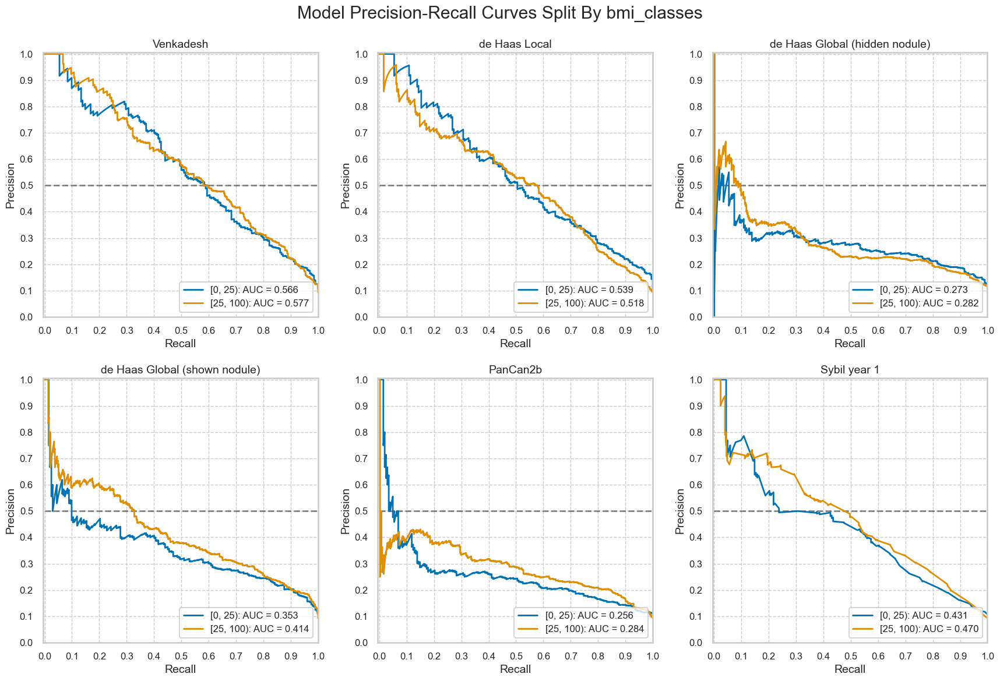

,num,pct,num_mal,pct_mal
"[0, 25)",1880,31.907671,202,10.744681
"[25, 100)",4012,68.092329,372,9.272183


Not binary: not computing significance test results.


In [23]:
nlst_preds['bmi_classes'] = pd.cut(nlst_preds['BMI'], bins=[0, 
                                                            # 18.5, 
                                                            25, 
                                                            # 30, 
                                                            100], right=False)
display(nlst_preds.groupby('bmi_classes')[['label', 'BMI']].describe())
plot_by_category(nlst_preds, f'bmi_classes')

### Smoking columns

#### pkyr

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,57.459653,24.397554,30.0,40.0,50.0,68.0,260.0
1,581.0,66.164716,30.131594,30.0,45.0,56.0,84.0,232.0


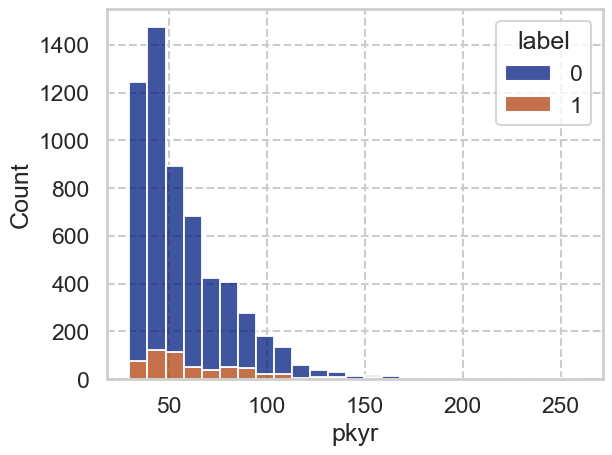

#### smokeage

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,16.524015,3.508332,5.0,15.0,16.0,18.0,40.0
1,581.0,16.204819,3.520048,6.0,14.0,16.0,18.0,30.0


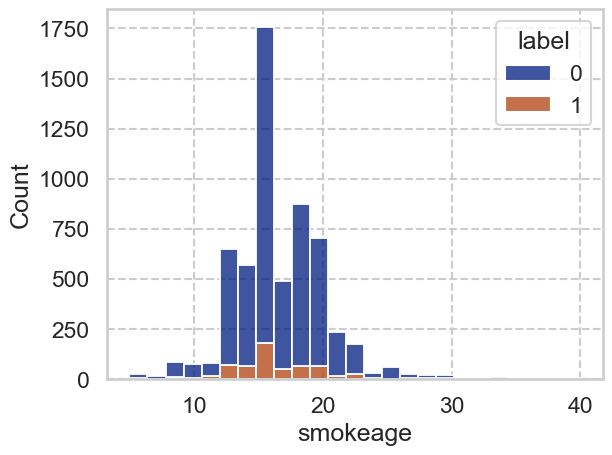

#### smokeday

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,28.436961,11.575912,12.0,20.0,25.0,35.0,135.0
1,581.0,30.485370,12.745731,15.0,20.0,30.0,40.0,80.0


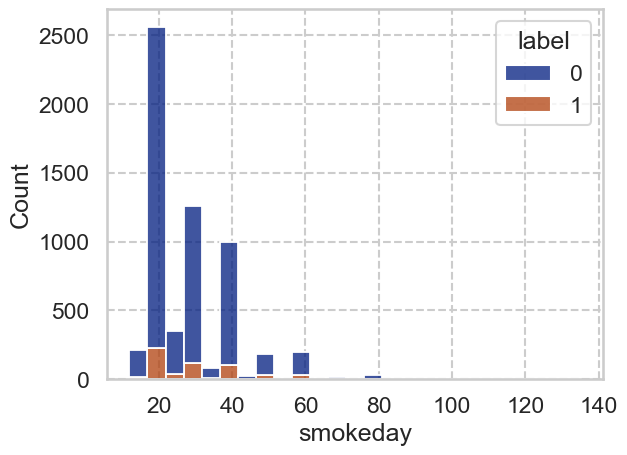

#### smokeyr

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,40.903940,7.364423,16.0,36.0,41.0,46.0,67.0
1,581.0,43.595525,7.225905,25.0,39.0,44.0,49.0,65.0


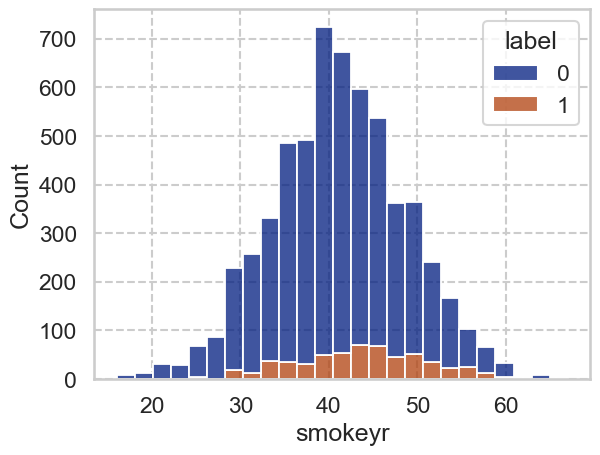

In [24]:
for c in nlst_democols['num']['smoke']:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\3728513433.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                                 pkyr  \
                 count      mean       std  min  25%  50%  75%  max   count   
bin_pkyr                                                                      
(29.999, 51.0]  3027.0  0.079617  0.270744  0.0  0.0  0.0  0.0  1.0  3027.0   
(51.0, 260.0]   2884.0  0.117892  0.322536  0.0  0.0  0.0  0.0  1.0  2884.0   

                                                                      
                     mean        std    min   25%   50%   75%    max  
bin_pkyr                                                              
(29.999, 51.0]  40.627800   5.760036  30.00  36.0  41.0  45.0   51.0  
(51.0, 260.0]   76.879785  24.261537  51.25  60.0  70.0  87.5  260.0

#### bin_pkyr

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


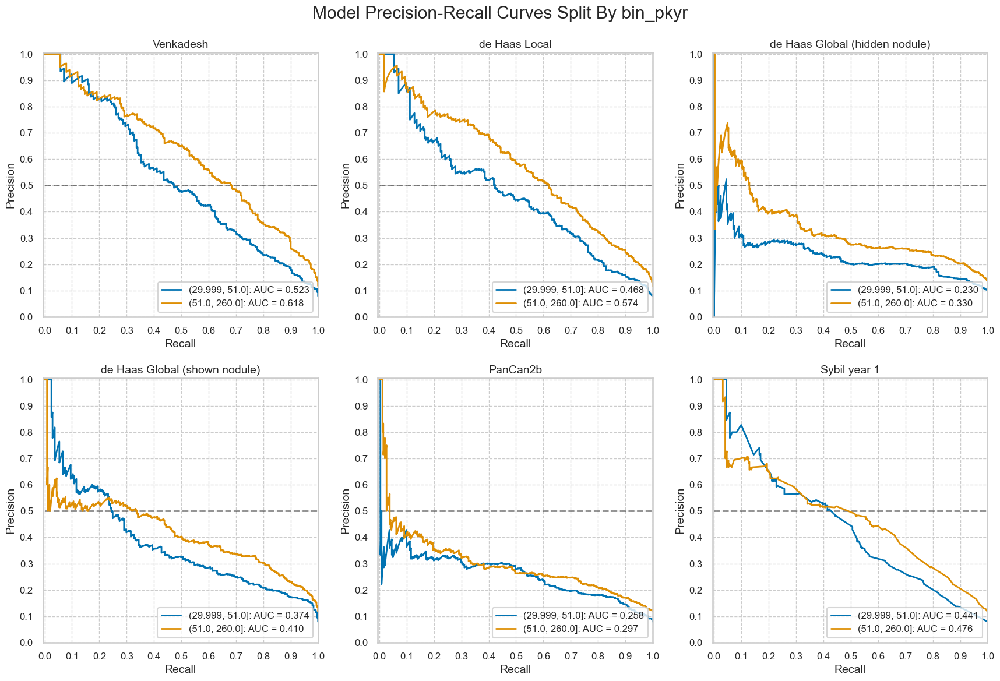

,num,pct,num_mal,pct_mal
"(29.999, 51.0]",3027,51.209609,241,7.961678
"(51.0, 260.0]",2884,48.790391,340,11.789182


Not binary: not computing significance test results.


C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\3728513433.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                              smokeage  \
                count      mean       std  min  25%  50%  75%  max    count   
bin_smokeage                                                                  
(4.999, 16.0]  3256.0  0.106572  0.308616  0.0  0.0  0.0  0.0  1.0   3256.0   
(16.0, 40.0]   2655.0  0.088136  0.283545  0.0  0.0  0.0  0.0  1.0   2655.0   

                                                                  
                    mean       std   min   25%   50%   75%   max  
bin_smokeage                                                      
(4.999, 16.0]  14.136978  2.000377   5.0  13.0  15.0  16.0  16.0  
(16.0, 40.0]   19.381544  2.716198  17.0  18.0  18.0  20.0  40.0

#### bin_smokeage

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


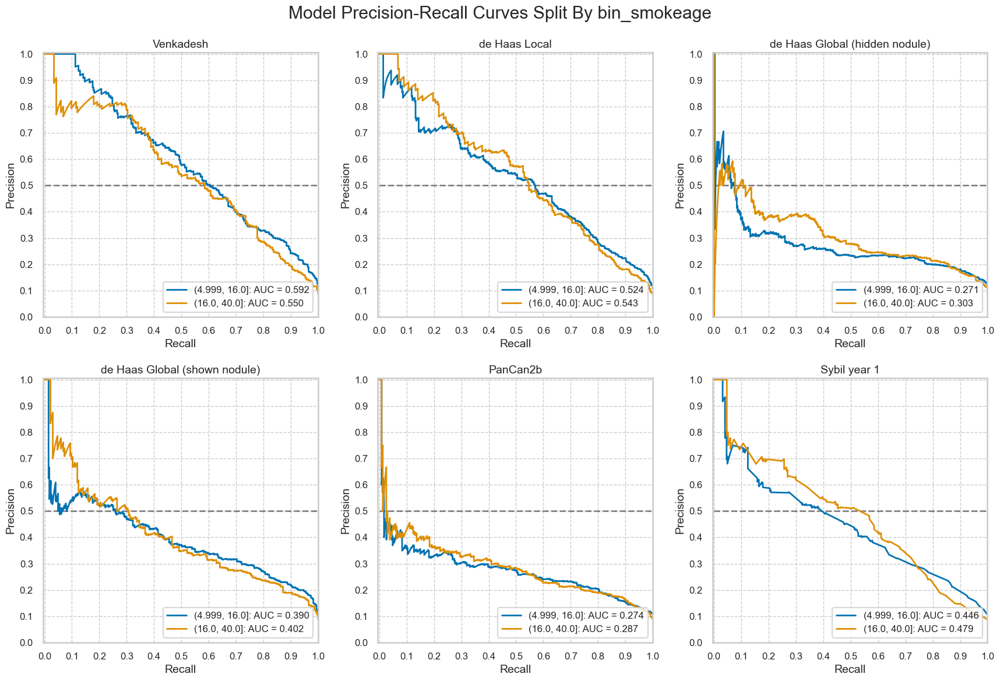

,num,pct,num_mal,pct_mal
"(4.999, 16.0]",3256,55.083742,347,10.657248
"(16.0, 40.0]",2655,44.916258,234,8.813559


Not binary: not computing significance test results.


C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\3728513433.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                              smokeday  \
                 count      mean       std  min  25%  50%  75%  max    count   
bin_smokeday                                                                   
(11.999, 25.0]  3119.0  0.089772  0.285901  0.0  0.0  0.0  0.0  1.0   3119.0   
(25.0, 135.0]   2792.0  0.107808  0.310193  0.0  0.0  0.0  0.0  1.0   2792.0   

                                                                     
                     mean        std   min   25%   50%   75%    max  
bin_smokeday                                                         
(11.999, 25.0]  20.117025   2.153974  12.0  20.0  20.0  20.0   25.0  
(25.0, 135.0]   38.157593  10.650142  26.0  30.0  40.0  40.0  135.0

#### bin_smokeday

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


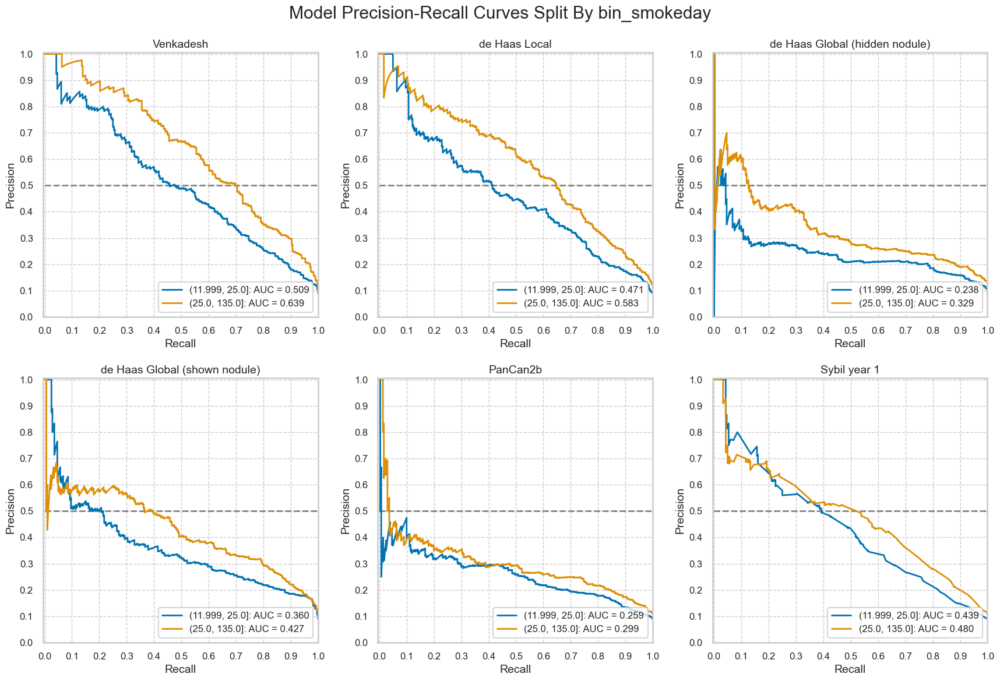

,num,pct,num_mal,pct_mal
"(11.999, 25.0]",3119,52.766029,280,8.977236
"(25.0, 135.0]",2792,47.233971,301,10.780802


Not binary: not computing significance test results.


C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\3728513433.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                              smokeyr  \
                 count      mean       std  min  25%  50%  75%  max   count   
bin_smokeyr                                                                   
(15.999, 41.0]  3073.0  0.070290  0.255676  0.0  0.0  0.0  0.0  1.0  3073.0   
(41.0, 67.0]    2838.0  0.128612  0.334829  0.0  0.0  0.0  0.0  1.0  2838.0   

                                                                   
                     mean       std   min   25%   50%   75%   max  
bin_smokeyr                                                        
(15.999, 41.0]  35.559714  4.645131  16.0  33.0  36.0  39.0  41.0  
(41.0, 67.0]    47.241720  4.421492  42.0  44.0  46.0  50.0  67.0

#### bin_smokeyr

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


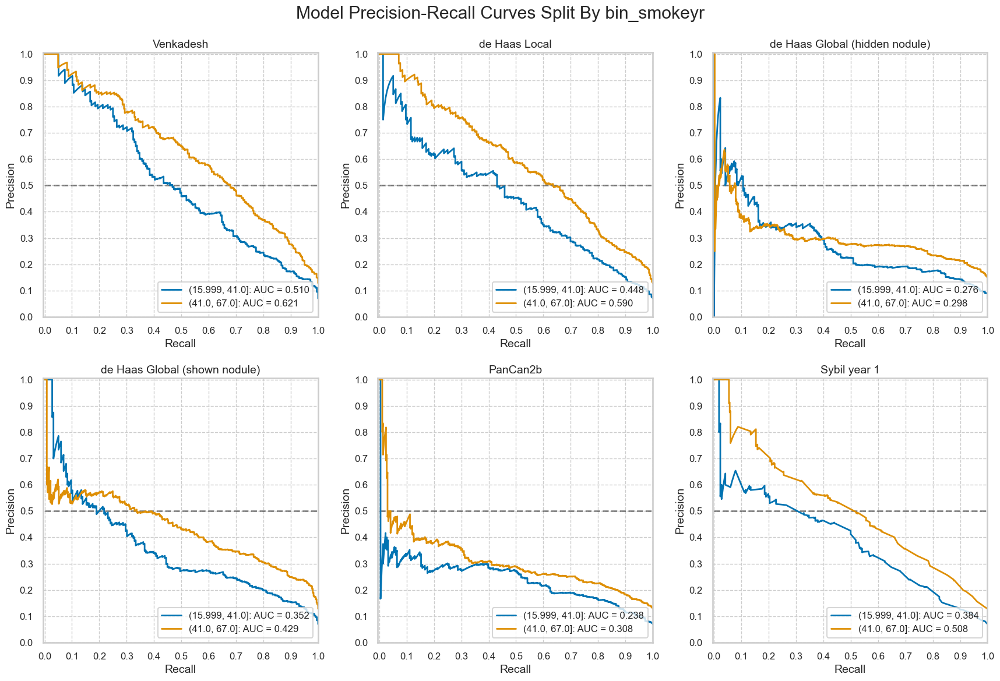

,num,pct,num_mal,pct_mal
"(15.999, 41.0]",3073,51.987819,216,7.028962
"(41.0, 67.0]",2838,48.012181,365,12.861170


Not binary: not computing significance test results.


In [25]:
for c in nlst_democols['num']['smoke']:
    nlst_preds[f'bin_{c}'] = pd.qcut(nlst_preds[c], q=2)
    display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())
    plot_by_category(nlst_preds, f'bin_{c}')

### Included columns from predictions

#### NoduleCounts

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,1.857786,1.240176,1.0,1.0,1.0,2.0,11.0
1,581.0,2.287435,1.300529,1.0,1.0,2.0,3.0,11.0


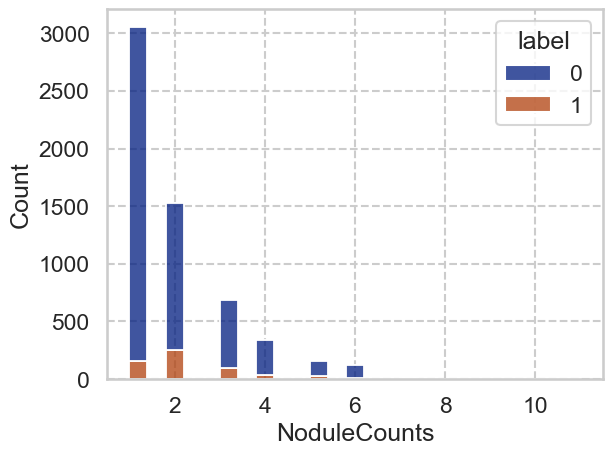

#### Diameter [mm]

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,8.446379,5.104287,4.0,5.2,6.8,9.7,64.7
1,581.0,14.567642,9.611311,4.1,8.5,12.2,17.8,83.0


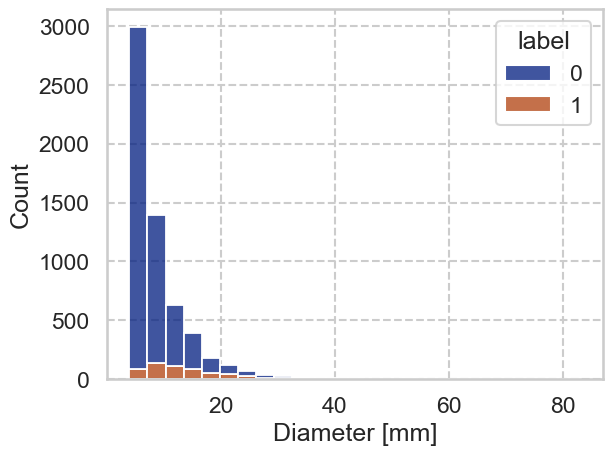

In [26]:
for c in nlst_democols['num']['other']:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\3226706664.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_NoduleCounts')[['label', f'NoduleCounts']].describe())


label                                               \
                   count      mean       std  min  25%  50%  75%  max   
bin_NoduleCounts                                                        
(0, 1]            3054.0  0.050753  0.219529  0.0  0.0  0.0  0.0  1.0   
(1, 12]           2857.0  0.149107  0.356257  0.0  0.0  0.0  0.0  1.0   

                 NoduleCounts                                                
                        count      mean       std  min  25%  50%  75%   max  
bin_NoduleCounts                                                             
(0, 1]                 3054.0  1.000000  0.000000  1.0  1.0  1.0  1.0   1.0  
(1, 12]                2857.0  2.862093  1.206261  2.0  2.0  2.0  3.0  11.0

#### bin_NoduleCounts

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


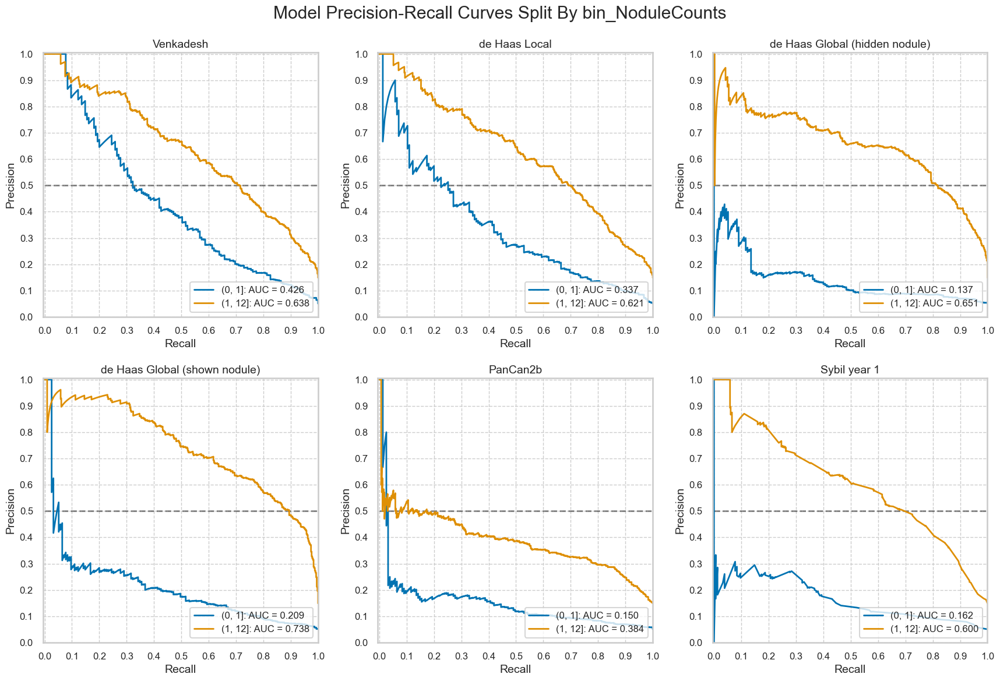

,num,pct,num_mal,pct_mal
"(0, 1]",3054,51.666385,155,5.075311
"(1, 12]",2857,48.333615,426,14.910746


Not binary: not computing significance test results.


In [27]:
# for c in included_num_cols:
#     nlst_preds[f'bin_{c}'] = pd.qcut(nlst_preds[c], q=2, duplicates='drop')
#     display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())
#     plot_by_category(nlst_preds, f'bin_{c}')
nlst_preds['bin_NoduleCounts'] = pd.cut(nlst_preds['NoduleCounts'], bins=[0, 1, 12], right=True)
display(nlst_preds.groupby(f'bin_NoduleCounts')[['label', f'NoduleCounts']].describe())
plot_by_category(nlst_preds, f'bin_NoduleCounts')

C:\Users\shaur\AppData\Local\Temp\ipykernel_27576\3128368612.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_Diameter [mm]')[['label', f'Diameter [mm]']].describe())


label                                               \
                    count      mean       std  min  25%  50%  75%  max   
bin_Diameter [mm]                                                        
(3.999, 7.1]       2993.0  0.028065  0.165188  0.0  0.0  0.0  0.0  1.0   
(7.1, 83.0]        2918.0  0.170322  0.375980  0.0  0.0  0.0  0.0  1.0   

                  Diameter [mm]                                             \
                          count       mean       std  min  25%   50%   75%   
bin_Diameter [mm]                                                            
(3.999, 7.1]             2993.0   5.437755  0.878854  4.0  4.7   5.4   6.2   
(7.1, 83.0]              2918.0  12.751131  6.694085  7.2  8.5  10.6  14.6   

                         
                    max  
bin_Diameter [mm]        
(3.999, 7.1]        7.1  
(7.1, 83.0]        83.0

#### bin_Diameter [mm]

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:348: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


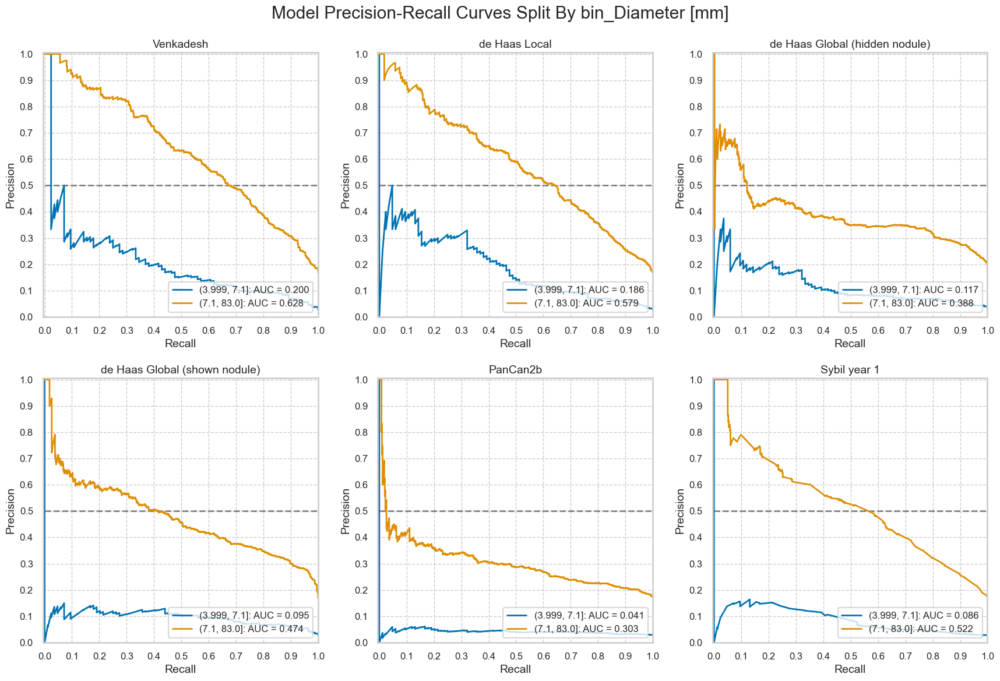

,num,pct,num_mal,pct_mal
"(3.999, 7.1]",2993,50.63441,84,2.806549
"(7.1, 83.0]",2918,49.36559,497,17.032214


Not binary: not computing significance test results.


In [28]:
nlst_preds['bin_Diameter [mm]'] = pd.qcut(nlst_preds['Diameter [mm]'], q=2)
display(nlst_preds.groupby(f'bin_Diameter [mm]')[['label', f'Diameter [mm]']].describe())
plot_by_category(nlst_preds, f'bin_Diameter [mm]')